# Inspect Multiruns Notebook

This notebook is designed to inspect and visualize multiple runs of anatomical image files generated by the cubids curation pipeline. It helps you quickly review the anatomical scans and verify that the data processing has been performed correctly. The notebook loads a TSV file with file paths, iterates over the anatomical images, and generates plots using Nilearn and Matplotlib.
   

In [1]:
import sys
sys.executable


'/gpfs/fs001/cbica/projects/grmpy/micromamba/envs/cubids/bin/python'

In [2]:
# Install required dependencies
import sys
!{sys.executable} -m pip install --user nilearn pandas matplotlib

In [5]:
from nilearn import plotting
import os
import pandas as pd
import matplotlib.pyplot as plt
import glob

# Define the base directory that should be prepended to each file path
base_dir = "/cbica/projects/grmpy/data/bids_datalad"

# Load the file list
file = "/cbica/projects/grmpy/code/curation/04_cubids_curation/v2/multiruns_for_inspection.tsv"
df = pd.read_csv(file, sep='\t')
anat_inspect = df.loc[df["Modality"] == "anat", "FilePath"]

# You can print the head of the sorted series to verify the ordering
print(anat_inspect.head())

0    /sub-109735/ses-1/anat/sub-109735_ses-1_rec-de...
1    /sub-109735/ses-1/anat/sub-109735_ses-1_rec-de...
2    /sub-112061/ses-1/anat/sub-112061_ses-1_rec-de...
3    /sub-112061/ses-1/anat/sub-112061_ses-1_rec-de...
4    /sub-117226/ses-1/anat/sub-117226_ses-1_run-01...
Name: FilePath, dtype: object


/sub-109735/ses-1/anat/sub-109735_ses-1_rec-defaced_run-01_T1w.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-109735/ses-1/anat/sub-109735_ses-1_rec-defaced_run-01_T1w.nii.gz


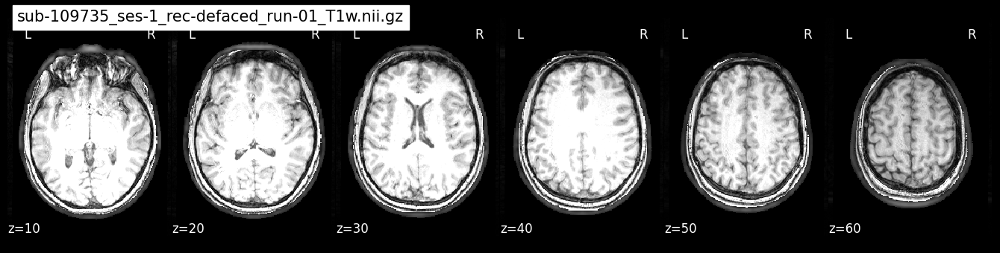

/sub-109735/ses-1/anat/sub-109735_ses-1_rec-defaced_run-02_T1w.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-109735/ses-1/anat/sub-109735_ses-1_rec-defaced_run-02_T1w.nii.gz


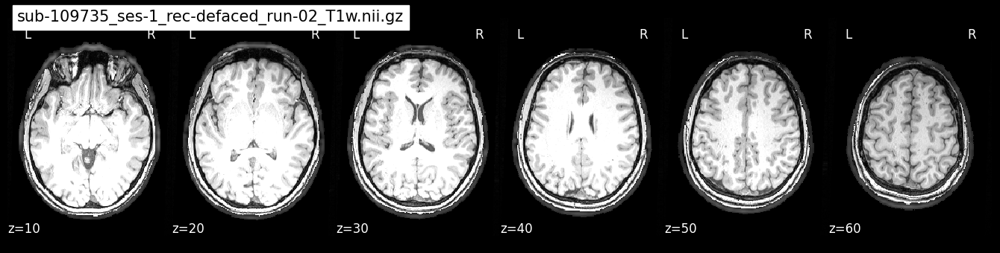

/sub-112061/ses-1/anat/sub-112061_ses-1_rec-defaced_run-01_T1w.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-112061/ses-1/anat/sub-112061_ses-1_rec-defaced_run-01_T1w.nii.gz


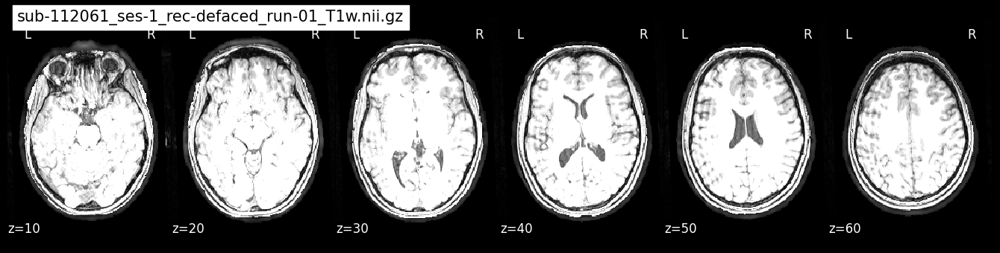

/sub-112061/ses-1/anat/sub-112061_ses-1_rec-defaced_run-02_T1w.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-112061/ses-1/anat/sub-112061_ses-1_rec-defaced_run-02_T1w.nii.gz


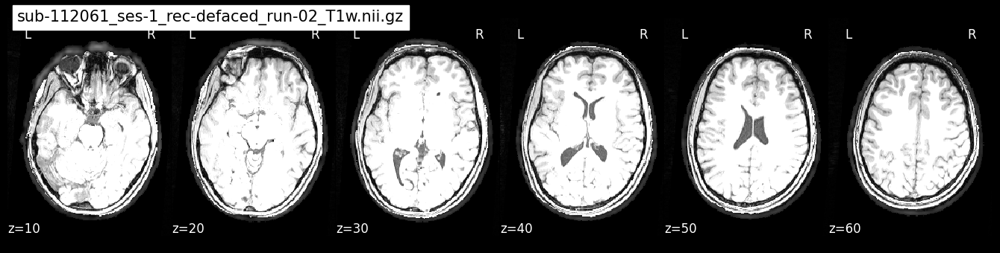

/sub-117226/ses-1/anat/sub-117226_ses-1_run-01_angio.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-117226/ses-1/anat/sub-117226_ses-1_run-01_angio.nii.gz


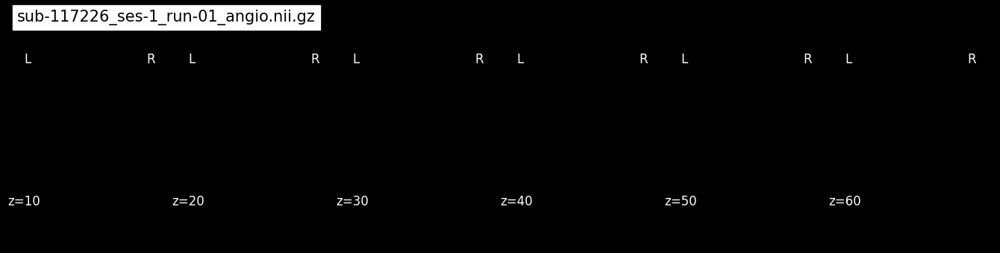

/sub-117226/ses-1/anat/sub-117226_ses-1_run-02_angio.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-117226/ses-1/anat/sub-117226_ses-1_run-02_angio.nii.gz


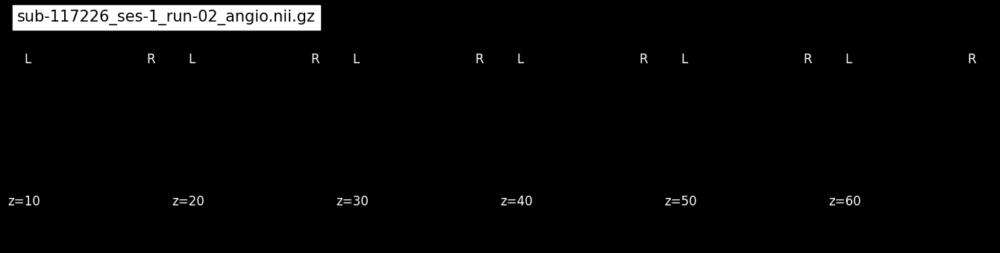

/sub-117226/ses-1/anat/sub-117226_ses-1_acq-axial_run-01_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-117226/ses-1/anat/sub-117226_ses-1_acq-axial_run-01_minIP.nii.gz


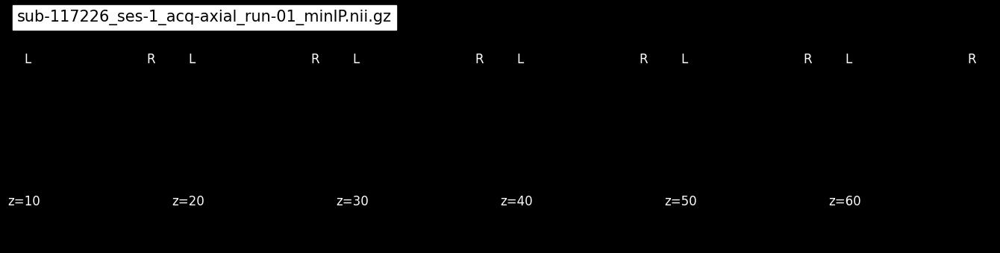

/sub-117226/ses-1/anat/sub-117226_ses-1_acq-axial_run-02_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-117226/ses-1/anat/sub-117226_ses-1_acq-axial_run-02_minIP.nii.gz


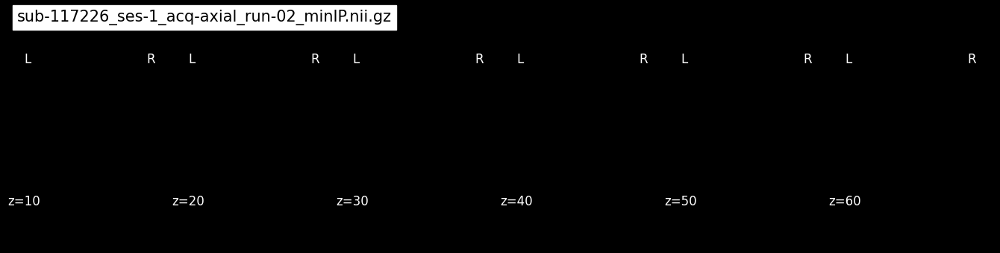

/sub-117226/ses-1/anat/sub-117226_ses-1_acq-coronal_run-01_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-117226/ses-1/anat/sub-117226_ses-1_acq-coronal_run-01_minIP.nii.gz


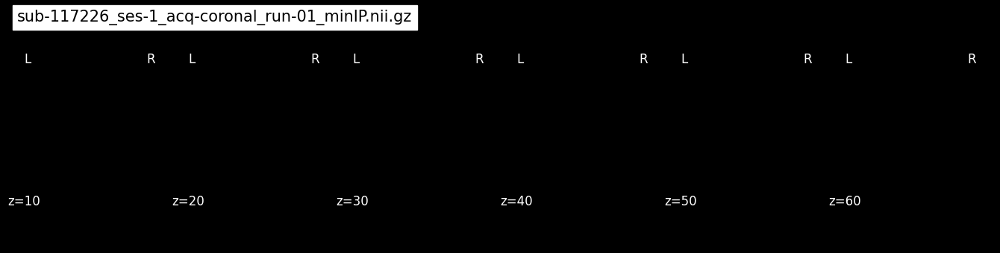

/sub-117226/ses-1/anat/sub-117226_ses-1_acq-coronal_run-02_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-117226/ses-1/anat/sub-117226_ses-1_acq-coronal_run-02_minIP.nii.gz


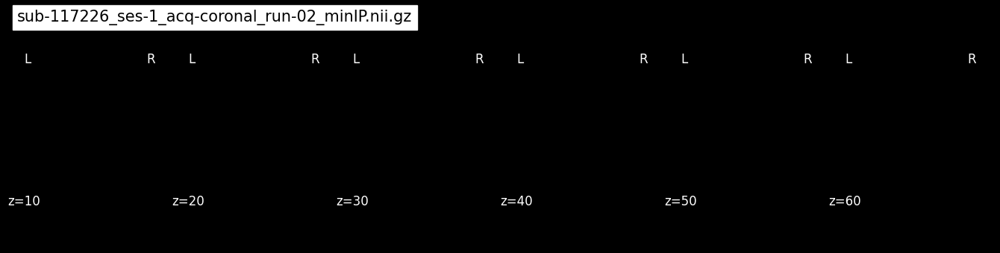

/sub-117226/ses-1/anat/sub-117226_ses-1_acq-sagittal_run-01_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-117226/ses-1/anat/sub-117226_ses-1_acq-sagittal_run-01_minIP.nii.gz


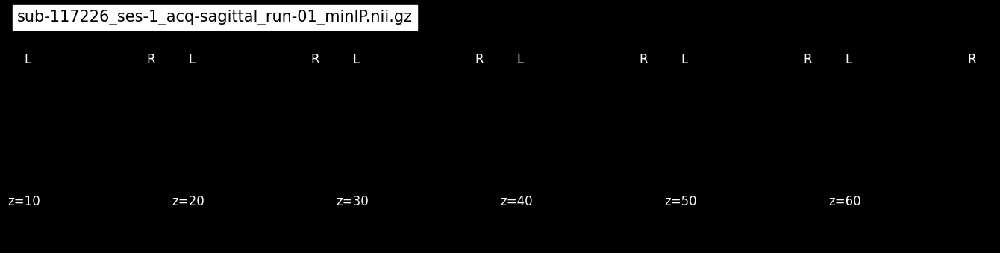

/sub-117226/ses-1/anat/sub-117226_ses-1_acq-sagittal_run-02_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-117226/ses-1/anat/sub-117226_ses-1_acq-sagittal_run-02_minIP.nii.gz


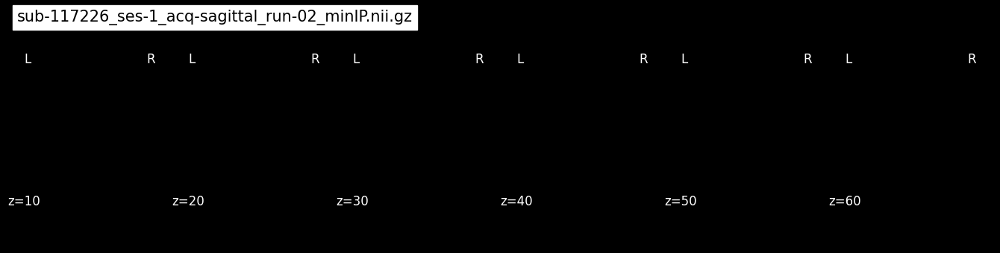

/sub-117226/ses-1/anat/sub-117226_ses-1_rec-defaced_run-01_T1w.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-117226/ses-1/anat/sub-117226_ses-1_rec-defaced_run-01_T1w.nii.gz


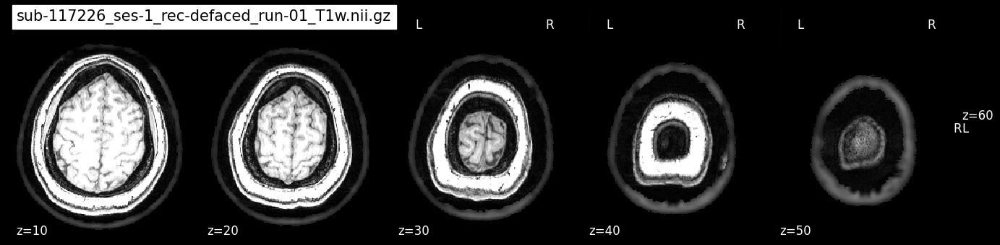

/sub-117226/ses-1/anat/sub-117226_ses-1_rec-defaced_run-02_T1w.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-117226/ses-1/anat/sub-117226_ses-1_rec-defaced_run-02_T1w.nii.gz


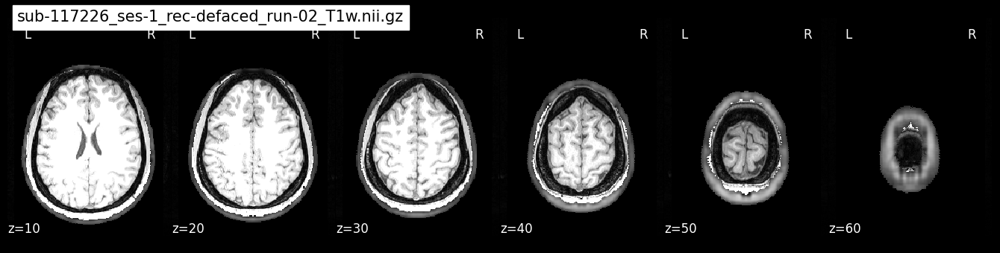

/sub-118393/ses-1/anat/sub-118393_ses-1_run-01_angio.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-118393/ses-1/anat/sub-118393_ses-1_run-01_angio.nii.gz


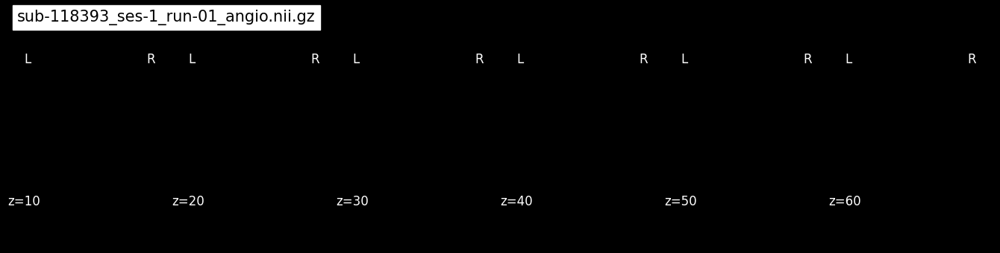

/sub-118393/ses-1/anat/sub-118393_ses-1_run-02_angio.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-118393/ses-1/anat/sub-118393_ses-1_run-02_angio.nii.gz


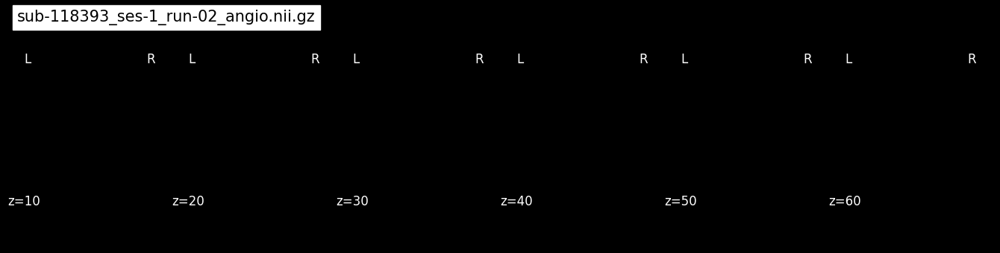

/sub-118393/ses-1/anat/sub-118393_ses-1_acq-axial_run-01_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-118393/ses-1/anat/sub-118393_ses-1_acq-axial_run-01_minIP.nii.gz


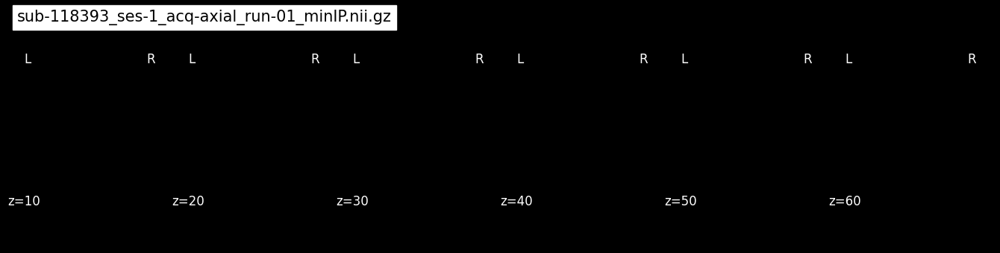

/sub-118393/ses-1/anat/sub-118393_ses-1_acq-axial_run-02_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-118393/ses-1/anat/sub-118393_ses-1_acq-axial_run-02_minIP.nii.gz


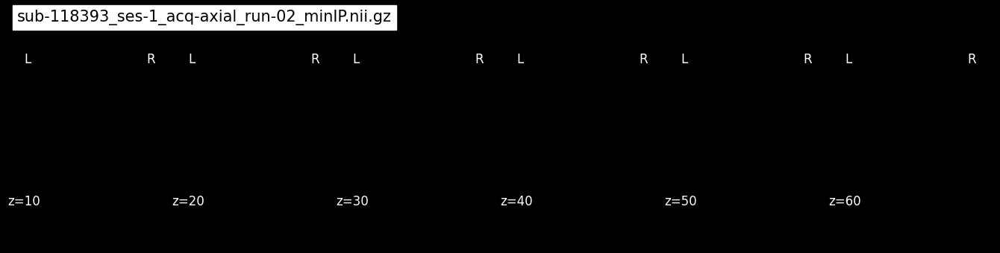

/sub-118393/ses-1/anat/sub-118393_ses-1_acq-coronal_run-01_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-118393/ses-1/anat/sub-118393_ses-1_acq-coronal_run-01_minIP.nii.gz


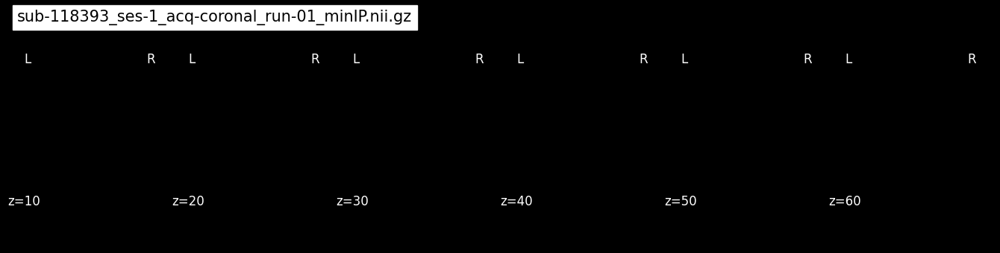

/sub-118393/ses-1/anat/sub-118393_ses-1_acq-coronal_run-02_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-118393/ses-1/anat/sub-118393_ses-1_acq-coronal_run-02_minIP.nii.gz


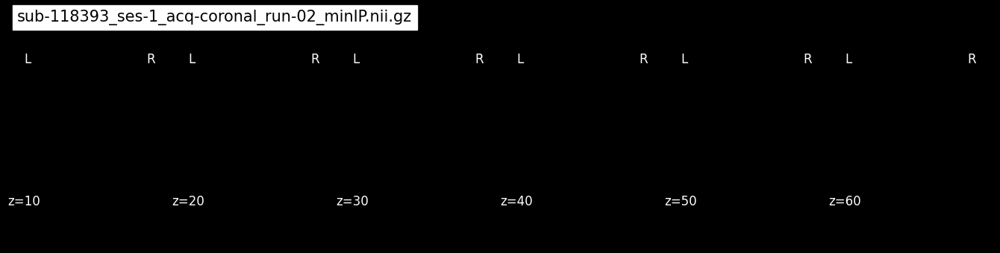

/sub-118393/ses-1/anat/sub-118393_ses-1_acq-sagittal_run-01_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-118393/ses-1/anat/sub-118393_ses-1_acq-sagittal_run-01_minIP.nii.gz


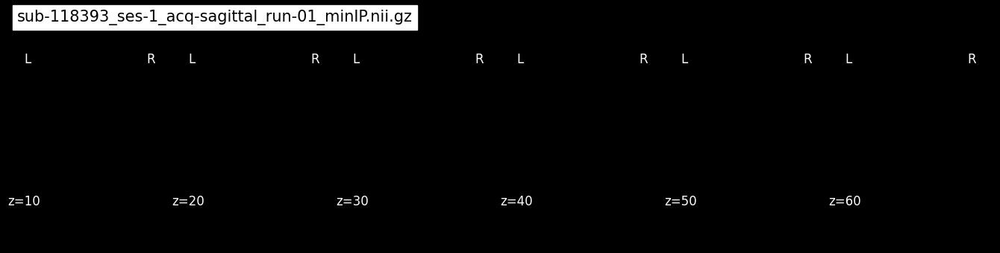

/sub-118393/ses-1/anat/sub-118393_ses-1_acq-sagittal_run-02_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-118393/ses-1/anat/sub-118393_ses-1_acq-sagittal_run-02_minIP.nii.gz


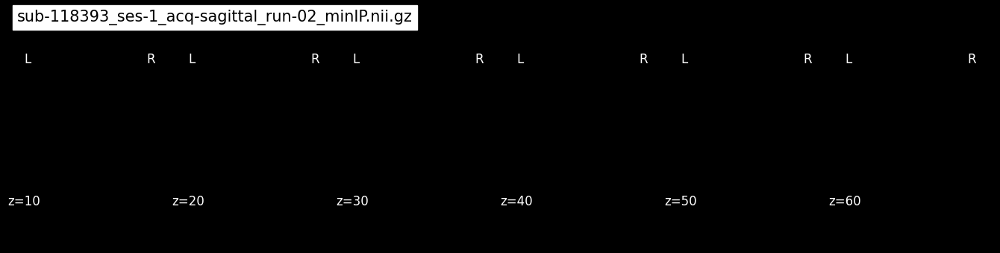

/sub-121407/ses-1/anat/sub-121407_ses-1_run-01_angio.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-121407/ses-1/anat/sub-121407_ses-1_run-01_angio.nii.gz


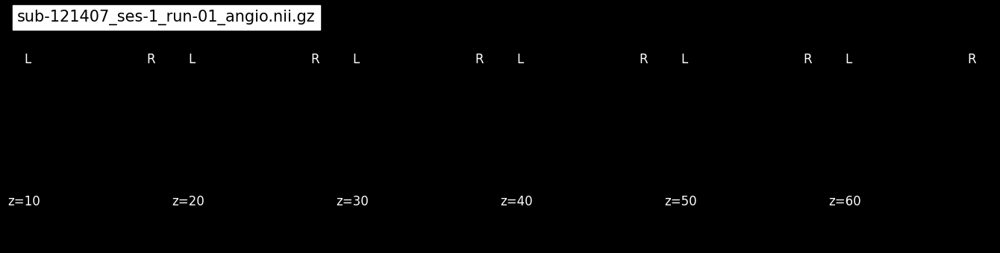

/sub-121407/ses-1/anat/sub-121407_ses-1_run-02_angio.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-121407/ses-1/anat/sub-121407_ses-1_run-02_angio.nii.gz


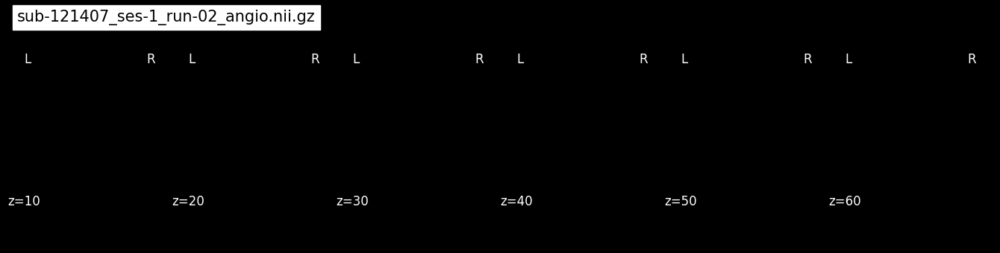

/sub-121407/ses-1/anat/sub-121407_ses-1_acq-axial_run-01_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-121407/ses-1/anat/sub-121407_ses-1_acq-axial_run-01_minIP.nii.gz


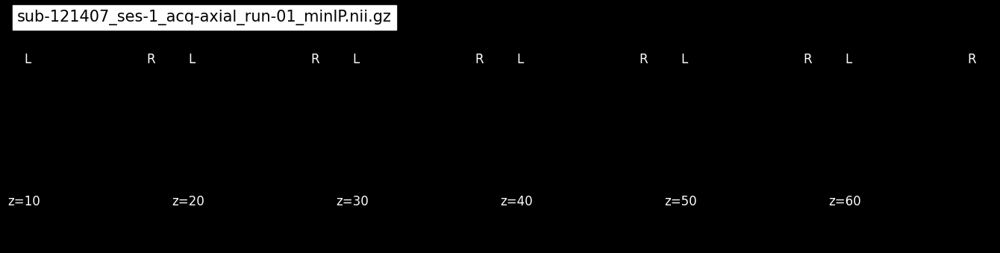

/sub-121407/ses-1/anat/sub-121407_ses-1_acq-axial_run-02_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-121407/ses-1/anat/sub-121407_ses-1_acq-axial_run-02_minIP.nii.gz


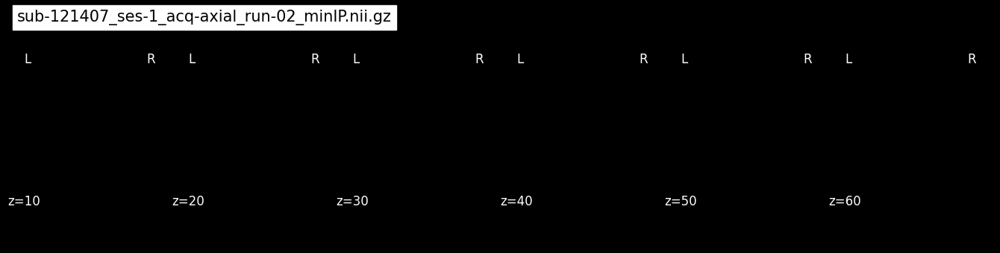

/sub-121407/ses-1/anat/sub-121407_ses-1_acq-coronal_run-01_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-121407/ses-1/anat/sub-121407_ses-1_acq-coronal_run-01_minIP.nii.gz


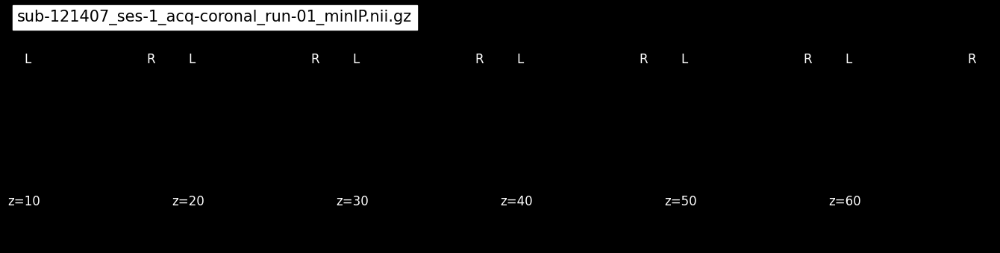

/sub-121407/ses-1/anat/sub-121407_ses-1_acq-coronal_run-02_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-121407/ses-1/anat/sub-121407_ses-1_acq-coronal_run-02_minIP.nii.gz


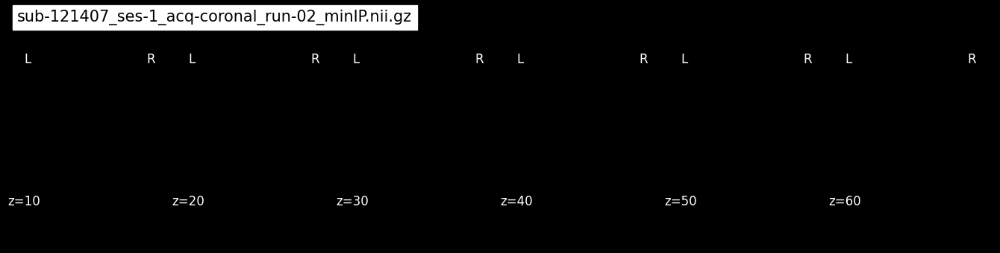

/sub-121407/ses-1/anat/sub-121407_ses-1_acq-sagittal_run-01_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-121407/ses-1/anat/sub-121407_ses-1_acq-sagittal_run-01_minIP.nii.gz


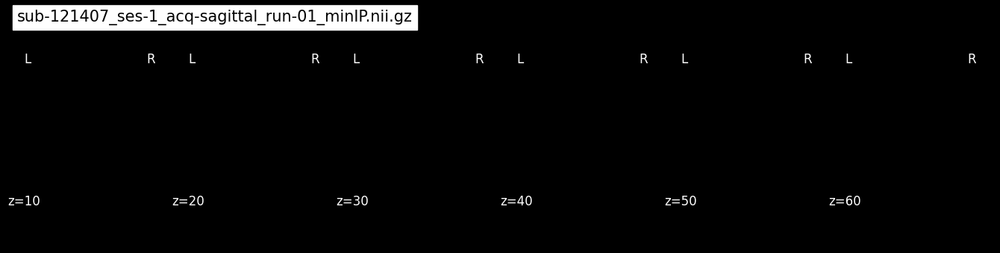

/sub-121407/ses-1/anat/sub-121407_ses-1_acq-sagittal_run-02_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-121407/ses-1/anat/sub-121407_ses-1_acq-sagittal_run-02_minIP.nii.gz


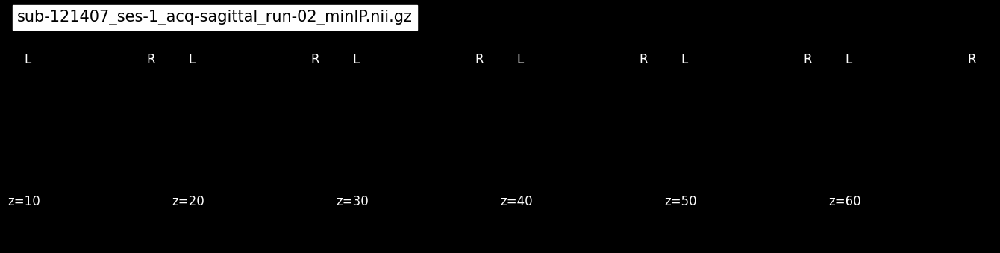

/sub-121407/ses-1/anat/sub-121407_ses-1_rec-defaced_run-01_T1w.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-121407/ses-1/anat/sub-121407_ses-1_rec-defaced_run-01_T1w.nii.gz


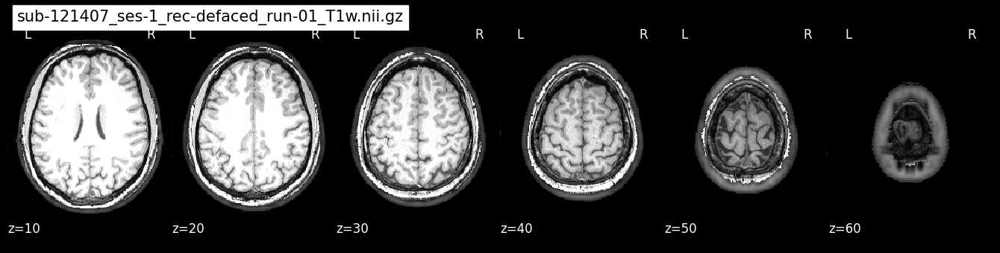

/sub-121407/ses-1/anat/sub-121407_ses-1_rec-defaced_run-02_T1w.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-121407/ses-1/anat/sub-121407_ses-1_rec-defaced_run-02_T1w.nii.gz


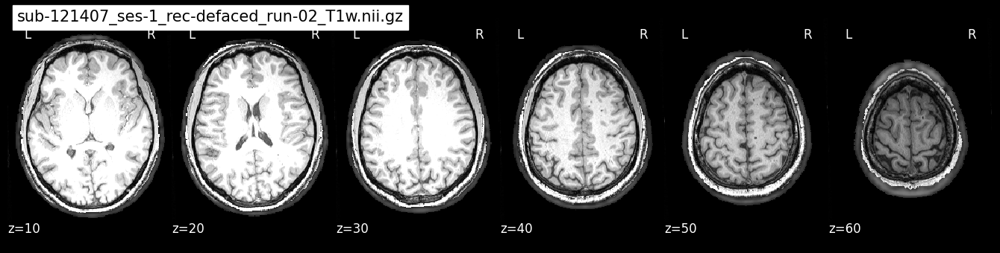

/sub-129405/ses-1/anat/sub-129405_ses-1_rec-defaced_run-01_T1w.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-129405/ses-1/anat/sub-129405_ses-1_rec-defaced_run-01_T1w.nii.gz


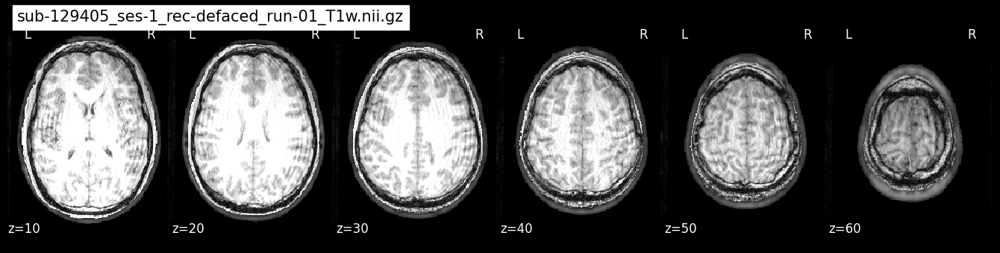

/sub-129405/ses-1/anat/sub-129405_ses-1_rec-defaced_run-02_T1w.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-129405/ses-1/anat/sub-129405_ses-1_rec-defaced_run-02_T1w.nii.gz


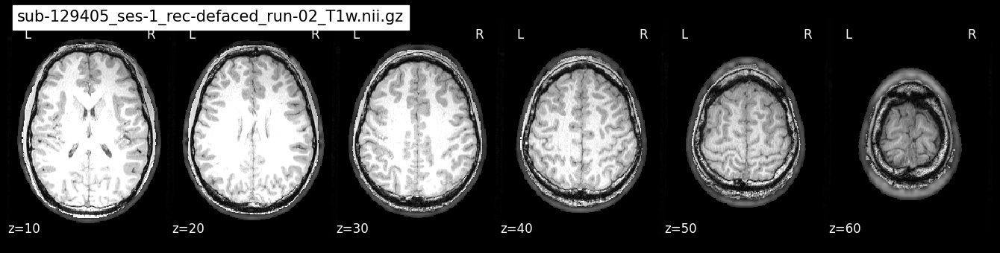

/sub-20940/ses-1/anat/sub-20940_ses-1_rec-defaced_run-01_T1w.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-20940/ses-1/anat/sub-20940_ses-1_rec-defaced_run-01_T1w.nii.gz


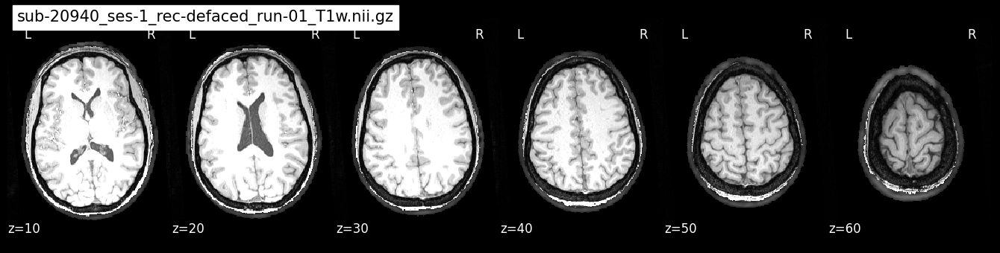

/sub-20940/ses-1/anat/sub-20940_ses-1_rec-defaced_run-02_T1w.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-20940/ses-1/anat/sub-20940_ses-1_rec-defaced_run-02_T1w.nii.gz


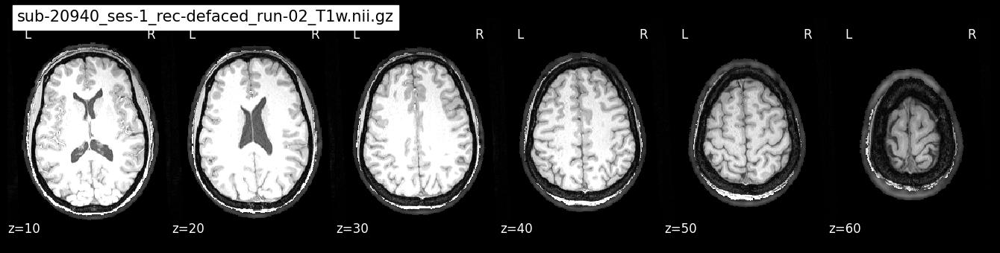

/sub-20981/ses-1/anat/sub-20981_ses-1_rec-defaced_run-01_T1w.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-20981/ses-1/anat/sub-20981_ses-1_rec-defaced_run-01_T1w.nii.gz


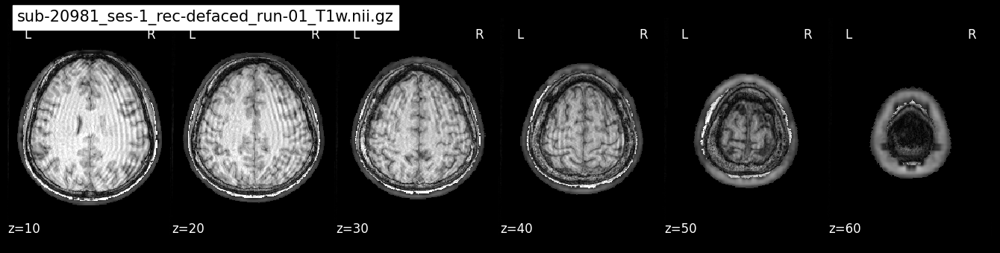

/sub-20981/ses-1/anat/sub-20981_ses-1_rec-defaced_run-02_T1w.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-20981/ses-1/anat/sub-20981_ses-1_rec-defaced_run-02_T1w.nii.gz


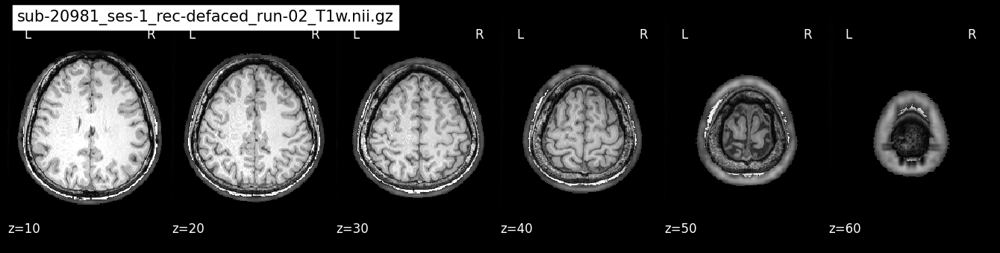

/sub-83999/ses-1/anat/sub-83999_ses-1_run-01_angio.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-83999/ses-1/anat/sub-83999_ses-1_run-01_angio.nii.gz


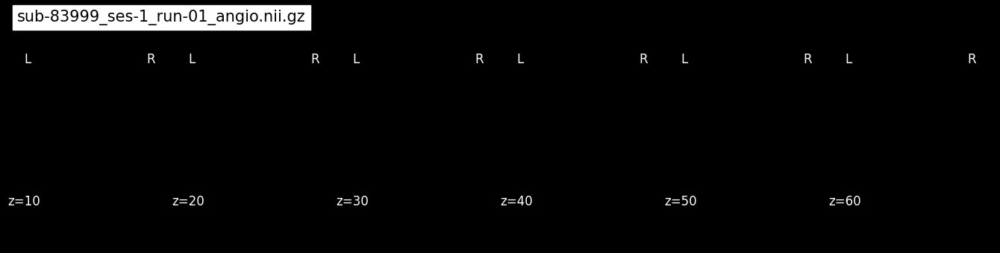

/sub-83999/ses-1/anat/sub-83999_ses-1_run-02_angio.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-83999/ses-1/anat/sub-83999_ses-1_run-02_angio.nii.gz


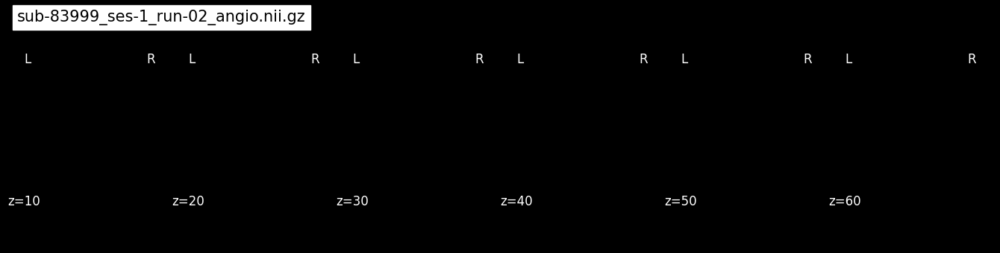

/sub-83999/ses-1/anat/sub-83999_ses-1_acq-axial_run-01_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-83999/ses-1/anat/sub-83999_ses-1_acq-axial_run-01_minIP.nii.gz


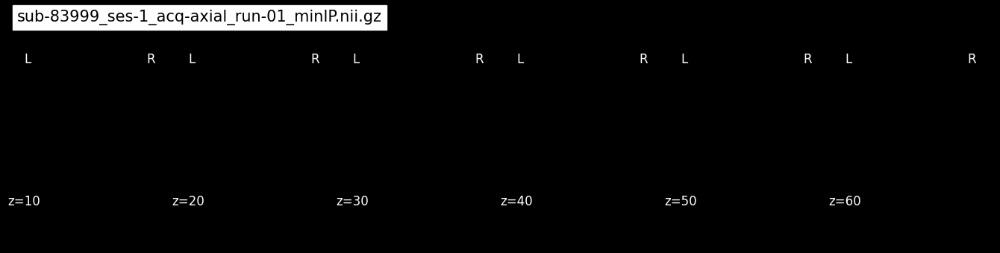

/sub-83999/ses-1/anat/sub-83999_ses-1_acq-axial_run-02_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-83999/ses-1/anat/sub-83999_ses-1_acq-axial_run-02_minIP.nii.gz


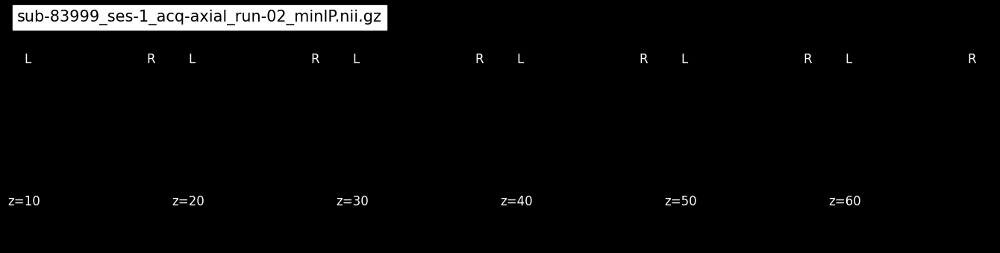

/sub-83999/ses-1/anat/sub-83999_ses-1_acq-coronal_run-01_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-83999/ses-1/anat/sub-83999_ses-1_acq-coronal_run-01_minIP.nii.gz


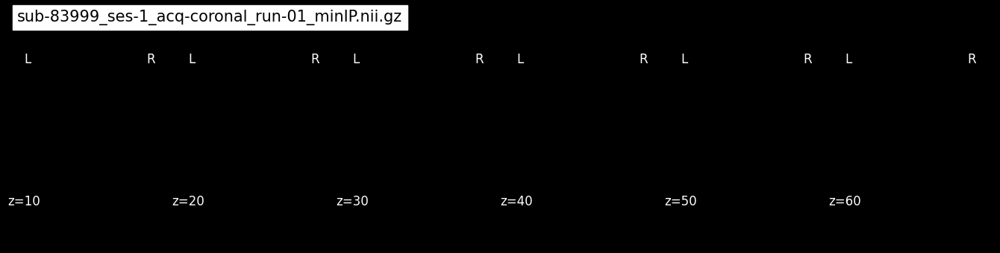

/sub-83999/ses-1/anat/sub-83999_ses-1_acq-coronal_run-02_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-83999/ses-1/anat/sub-83999_ses-1_acq-coronal_run-02_minIP.nii.gz


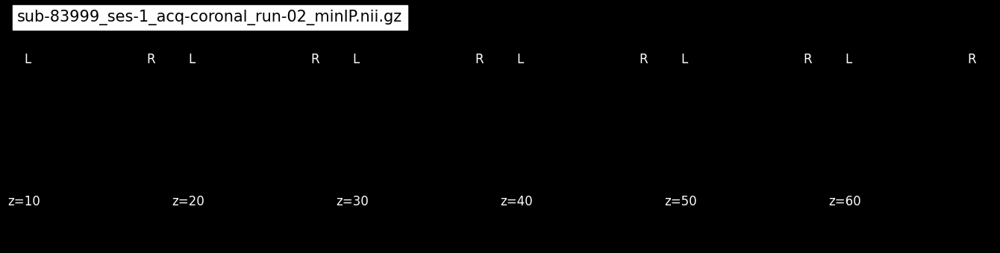

/sub-83999/ses-1/anat/sub-83999_ses-1_acq-sagittal_run-01_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-83999/ses-1/anat/sub-83999_ses-1_acq-sagittal_run-01_minIP.nii.gz


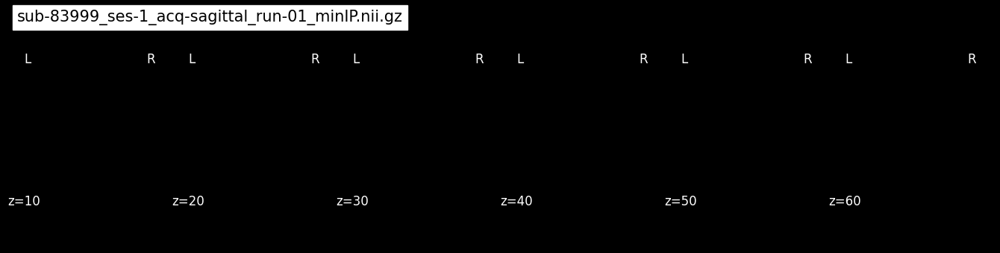

/sub-83999/ses-1/anat/sub-83999_ses-1_acq-sagittal_run-02_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-83999/ses-1/anat/sub-83999_ses-1_acq-sagittal_run-02_minIP.nii.gz


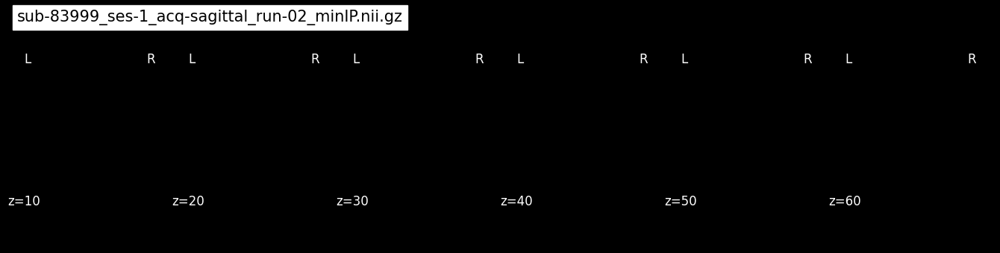

/sub-85173/ses-1/anat/sub-85173_ses-1_run-01_angio.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-85173/ses-1/anat/sub-85173_ses-1_run-01_angio.nii.gz


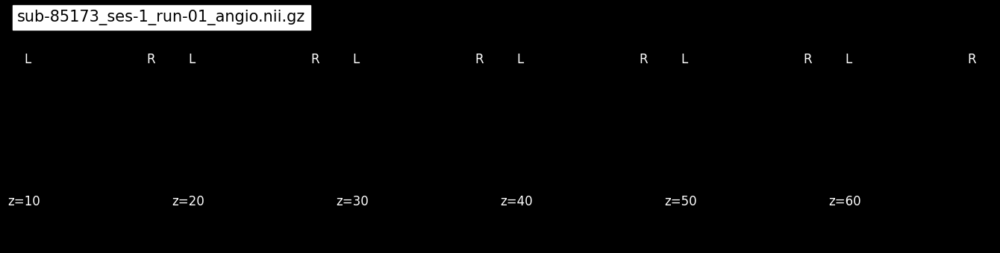

/sub-85173/ses-1/anat/sub-85173_ses-1_run-02_angio.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-85173/ses-1/anat/sub-85173_ses-1_run-02_angio.nii.gz


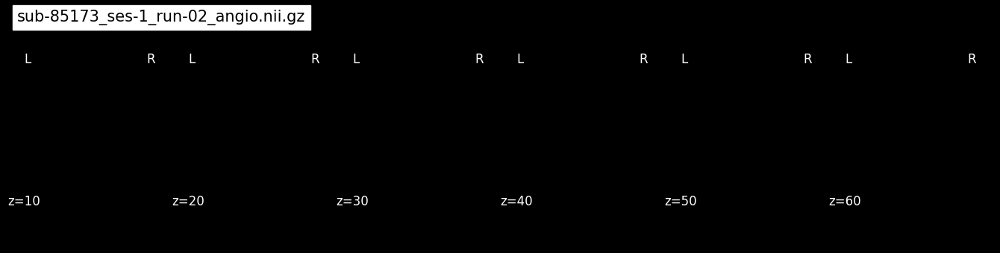

/sub-85173/ses-1/anat/sub-85173_ses-1_acq-axial_run-01_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-85173/ses-1/anat/sub-85173_ses-1_acq-axial_run-01_minIP.nii.gz


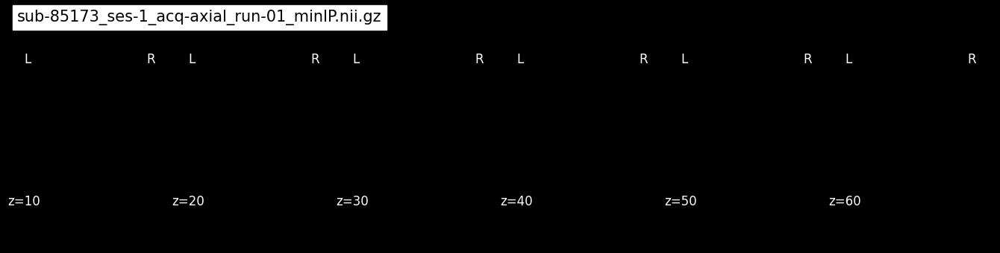

/sub-85173/ses-1/anat/sub-85173_ses-1_acq-axial_run-02_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-85173/ses-1/anat/sub-85173_ses-1_acq-axial_run-02_minIP.nii.gz


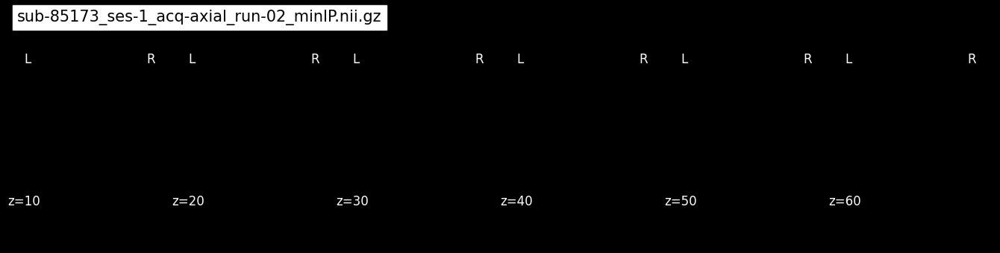

/sub-85173/ses-1/anat/sub-85173_ses-1_acq-coronal_run-01_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-85173/ses-1/anat/sub-85173_ses-1_acq-coronal_run-01_minIP.nii.gz


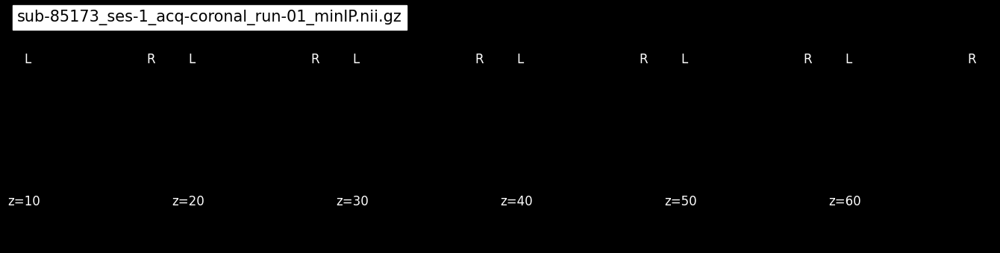

/sub-85173/ses-1/anat/sub-85173_ses-1_acq-coronal_run-02_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-85173/ses-1/anat/sub-85173_ses-1_acq-coronal_run-02_minIP.nii.gz


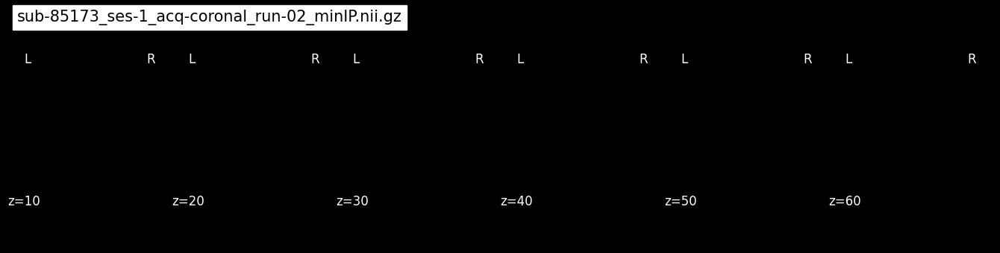

/sub-85173/ses-1/anat/sub-85173_ses-1_acq-sagittal_run-01_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-85173/ses-1/anat/sub-85173_ses-1_acq-sagittal_run-01_minIP.nii.gz


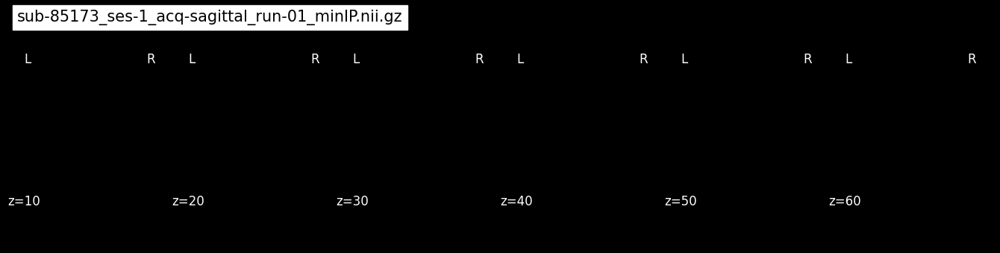

/sub-85173/ses-1/anat/sub-85173_ses-1_acq-sagittal_run-02_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-85173/ses-1/anat/sub-85173_ses-1_acq-sagittal_run-02_minIP.nii.gz


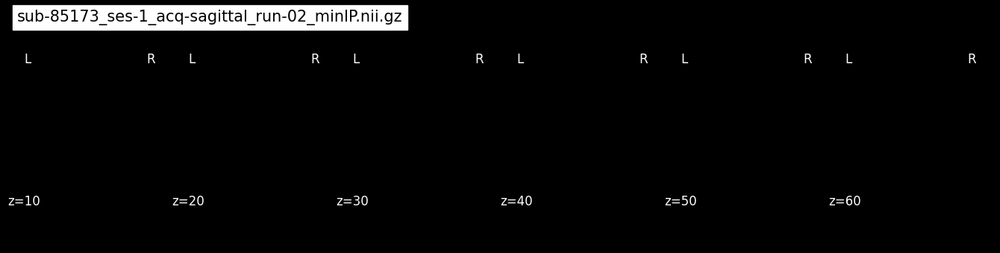

/sub-87538/ses-1/anat/sub-87538_ses-1_run-01_angio.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-87538/ses-1/anat/sub-87538_ses-1_run-01_angio.nii.gz


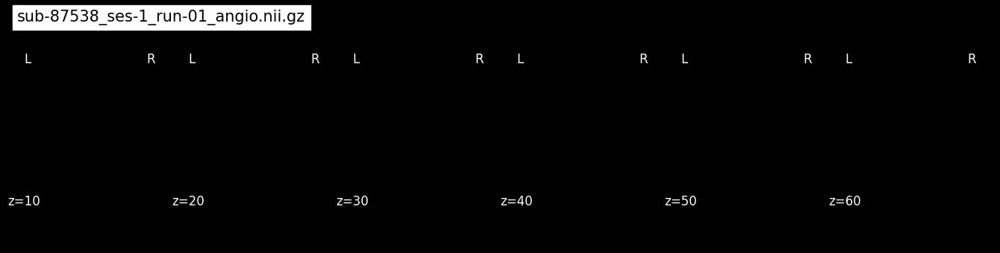

/sub-87538/ses-1/anat/sub-87538_ses-1_run-02_angio.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-87538/ses-1/anat/sub-87538_ses-1_run-02_angio.nii.gz


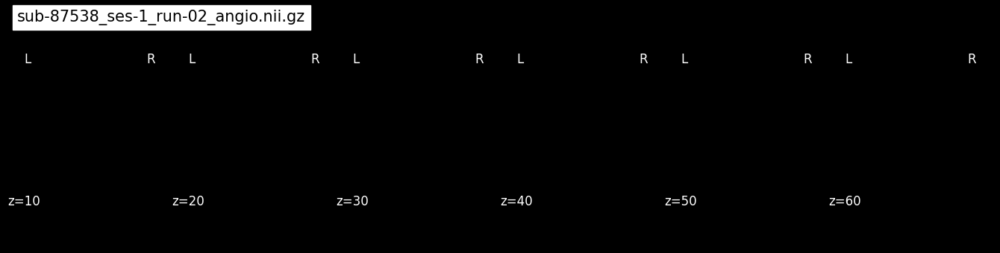

/sub-87538/ses-1/anat/sub-87538_ses-1_run-03_angio.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-87538/ses-1/anat/sub-87538_ses-1_run-03_angio.nii.gz


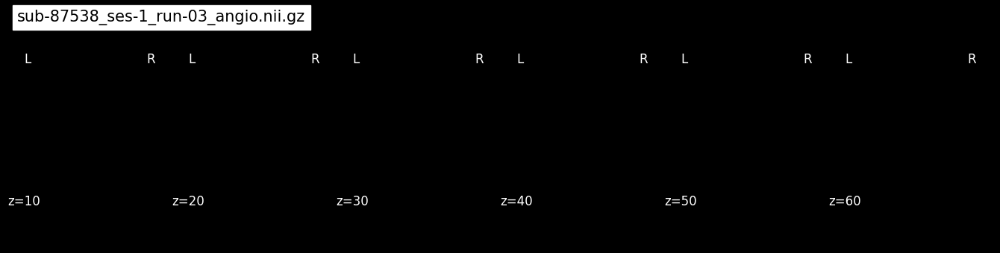

/sub-87538/ses-1/anat/sub-87538_ses-1_acq-axial_run-01_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-87538/ses-1/anat/sub-87538_ses-1_acq-axial_run-01_minIP.nii.gz


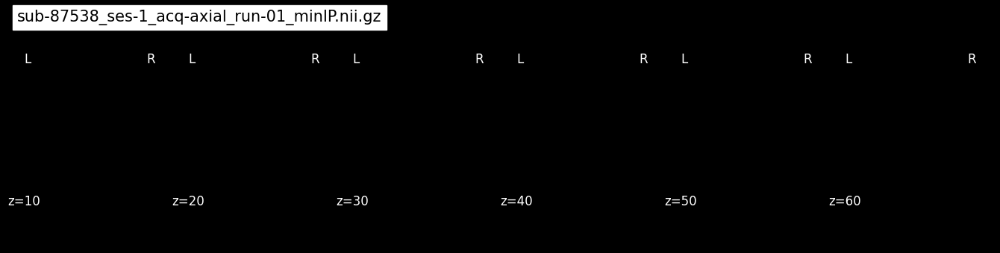

/sub-87538/ses-1/anat/sub-87538_ses-1_acq-axial_run-02_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-87538/ses-1/anat/sub-87538_ses-1_acq-axial_run-02_minIP.nii.gz


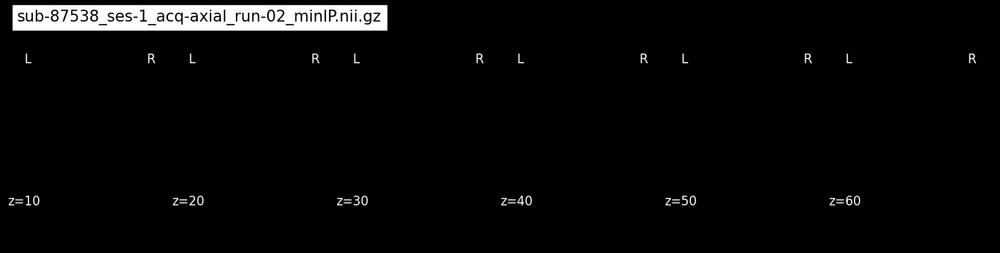

/sub-87538/ses-1/anat/sub-87538_ses-1_acq-axial_run-03_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-87538/ses-1/anat/sub-87538_ses-1_acq-axial_run-03_minIP.nii.gz


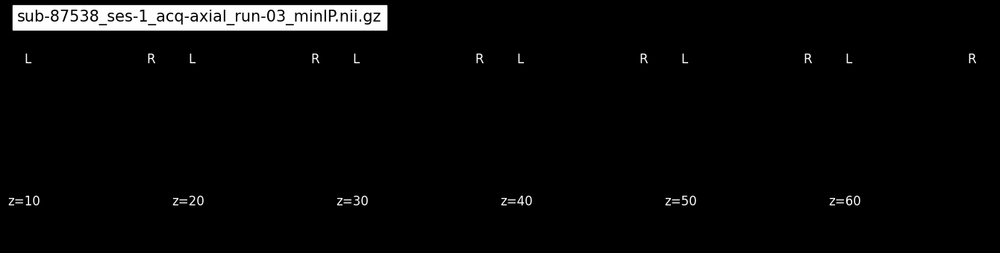

/sub-87538/ses-1/anat/sub-87538_ses-1_acq-coronal_run-01_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-87538/ses-1/anat/sub-87538_ses-1_acq-coronal_run-01_minIP.nii.gz


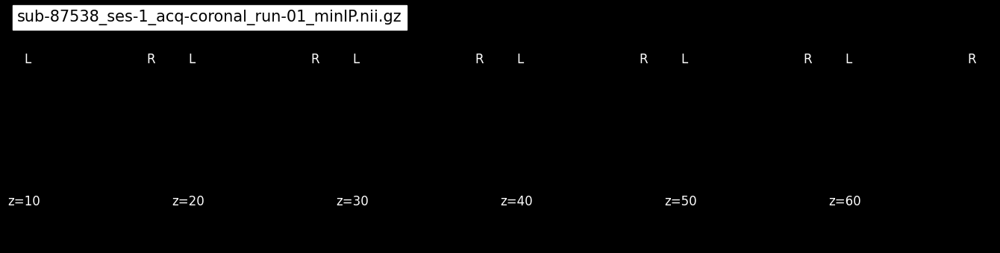

/sub-87538/ses-1/anat/sub-87538_ses-1_acq-coronal_run-02_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-87538/ses-1/anat/sub-87538_ses-1_acq-coronal_run-02_minIP.nii.gz


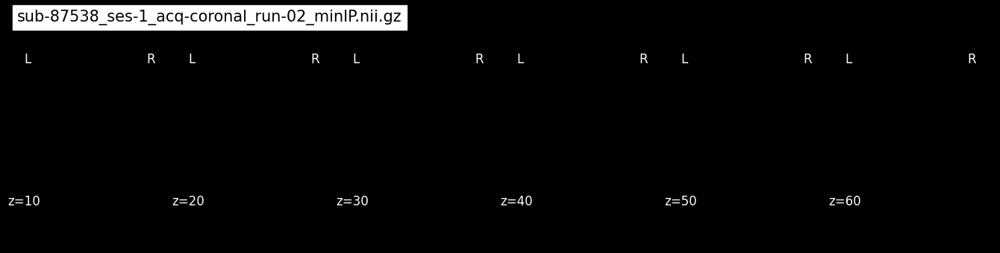

/sub-87538/ses-1/anat/sub-87538_ses-1_acq-coronal_run-03_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-87538/ses-1/anat/sub-87538_ses-1_acq-coronal_run-03_minIP.nii.gz


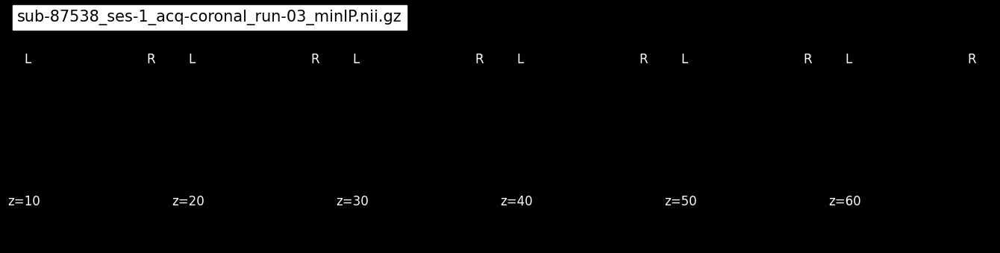

/sub-87538/ses-1/anat/sub-87538_ses-1_acq-sagittal_run-01_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-87538/ses-1/anat/sub-87538_ses-1_acq-sagittal_run-01_minIP.nii.gz


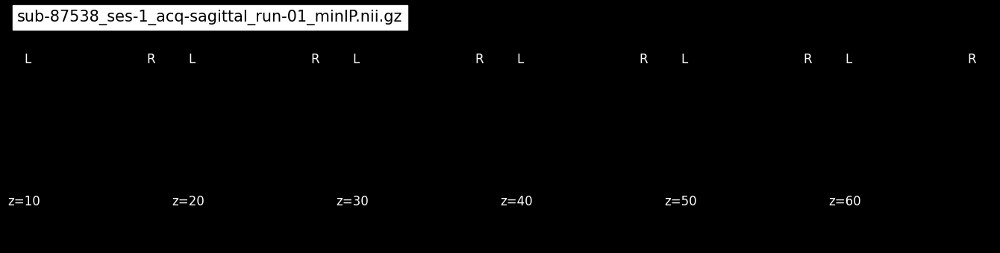

/sub-87538/ses-1/anat/sub-87538_ses-1_acq-sagittal_run-02_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-87538/ses-1/anat/sub-87538_ses-1_acq-sagittal_run-02_minIP.nii.gz


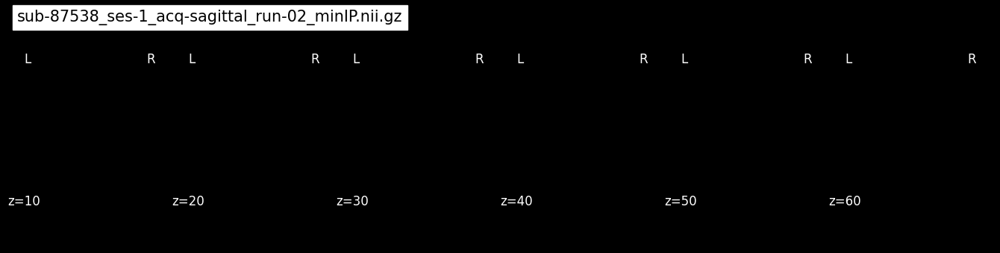

/sub-87538/ses-1/anat/sub-87538_ses-1_acq-sagittal_run-03_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-87538/ses-1/anat/sub-87538_ses-1_acq-sagittal_run-03_minIP.nii.gz


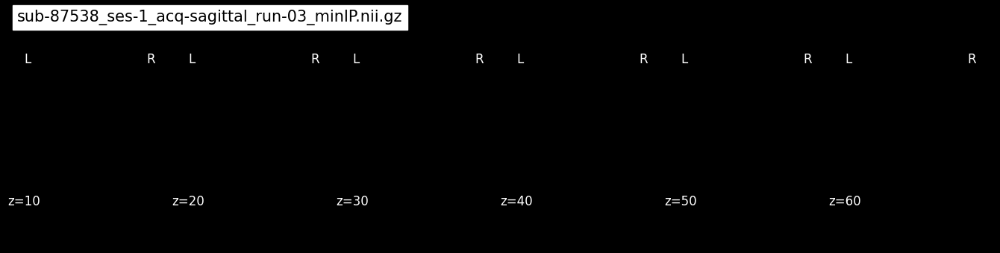

/sub-95015/ses-1/anat/sub-95015_ses-1_rec-defaced_run-01_T2w.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-95015/ses-1/anat/sub-95015_ses-1_rec-defaced_run-01_T2w.nii.gz


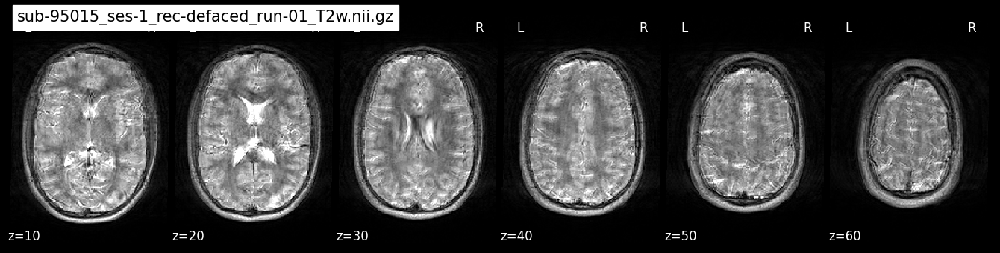

/sub-95015/ses-1/anat/sub-95015_ses-1_rec-defaced_run-02_T2w.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-95015/ses-1/anat/sub-95015_ses-1_rec-defaced_run-02_T2w.nii.gz


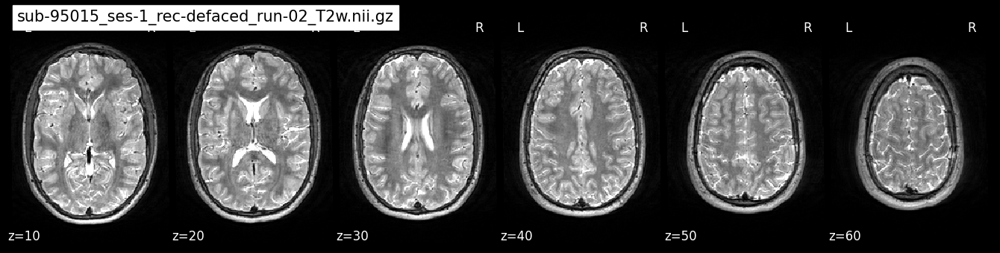

/sub-98394/ses-1/anat/sub-98394_ses-1_rec-defaced_run-01_T1w.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-98394/ses-1/anat/sub-98394_ses-1_rec-defaced_run-01_T1w.nii.gz


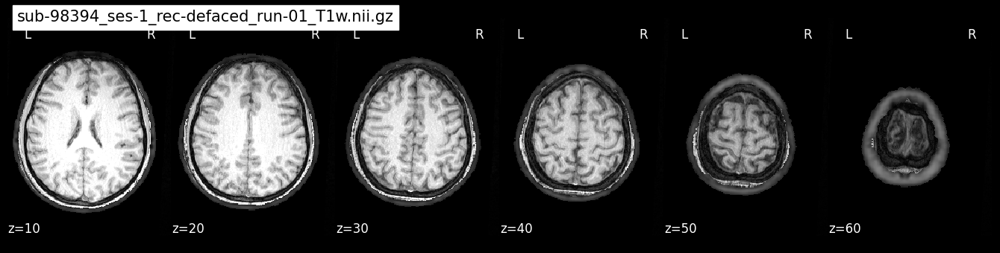

/sub-98394/ses-1/anat/sub-98394_ses-1_rec-defaced_run-02_T1w.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-98394/ses-1/anat/sub-98394_ses-1_rec-defaced_run-02_T1w.nii.gz


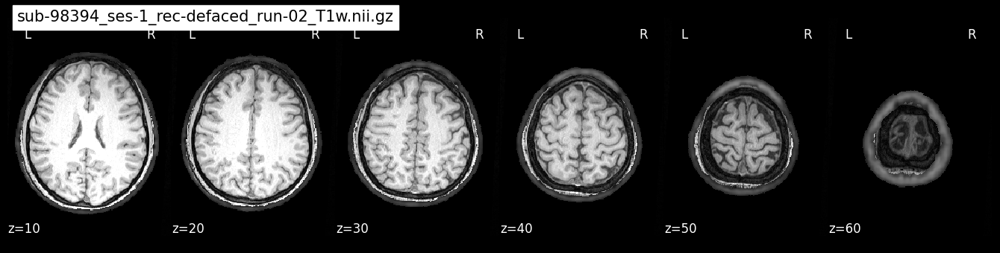

In [6]:
for file in anat_inspect:
    print(file)
    filename = os.path.basename(file)
    title = f"{filename}"
    file = file.lstrip('/')
    fullpath = os.path.join(base_dir, file)
    print(fullpath)
    # Generate the plot
    display = plotting.plot_anat(
        fullpath,
        title=title,
        draw_cross=False,
        annotate=True,
        display_mode='z',
        dim=-1,
        cut_coords=[10, 20, 30, 40, 50, 60]
    )

    plt.show()  # Display the plot
    display.close()  # Close the display object to free memory

/sub-109735/ses-1/anat/sub-109735_ses-1_rec-defaced_run-01_T1w.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-109735/ses-1/anat/sub-109735_ses-1_rec-defaced_run-01_T1w.nii.gz


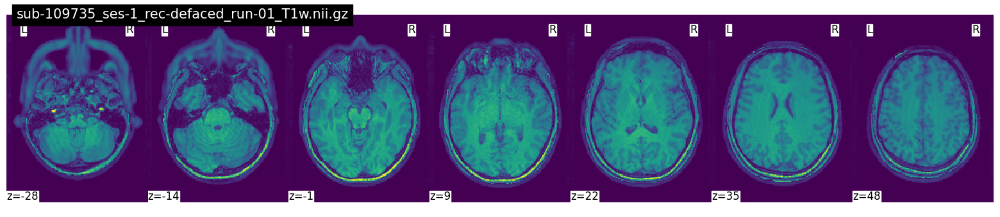

/sub-109735/ses-1/anat/sub-109735_ses-1_rec-defaced_run-02_T1w.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-109735/ses-1/anat/sub-109735_ses-1_rec-defaced_run-02_T1w.nii.gz


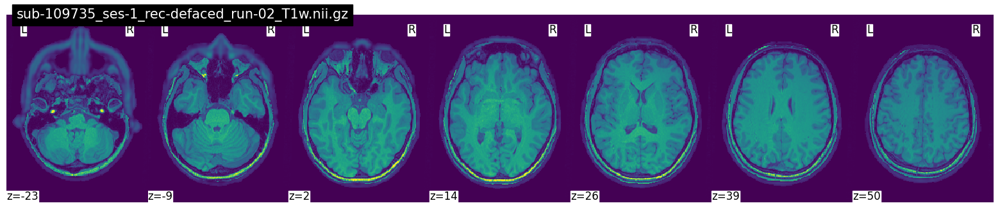

/sub-112061/ses-1/anat/sub-112061_ses-1_rec-defaced_run-01_T1w.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-112061/ses-1/anat/sub-112061_ses-1_rec-defaced_run-01_T1w.nii.gz


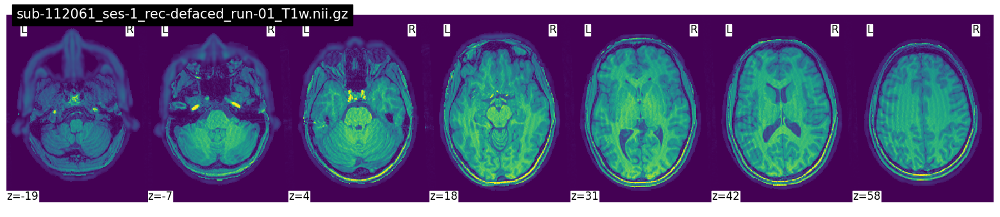

/sub-112061/ses-1/anat/sub-112061_ses-1_rec-defaced_run-02_T1w.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-112061/ses-1/anat/sub-112061_ses-1_rec-defaced_run-02_T1w.nii.gz


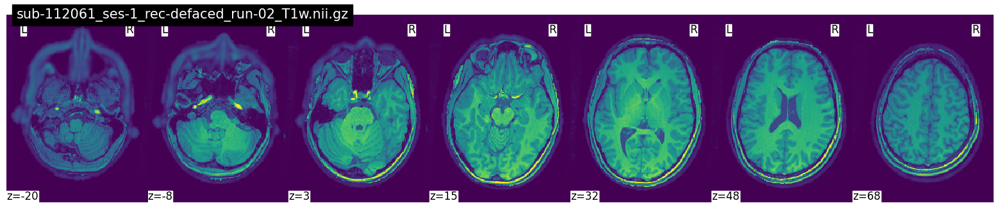

/sub-117226/ses-1/anat/sub-117226_ses-1_run-01_angio.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-117226/ses-1/anat/sub-117226_ses-1_run-01_angio.nii.gz


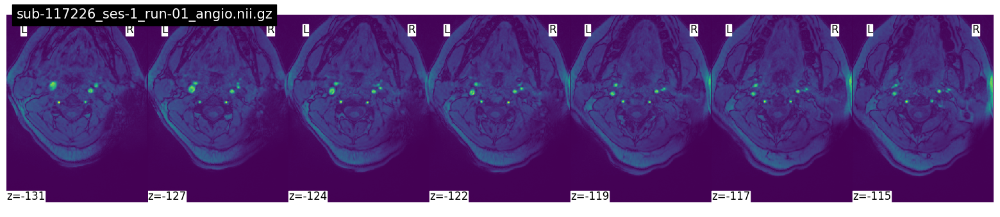

/sub-117226/ses-1/anat/sub-117226_ses-1_run-02_angio.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-117226/ses-1/anat/sub-117226_ses-1_run-02_angio.nii.gz


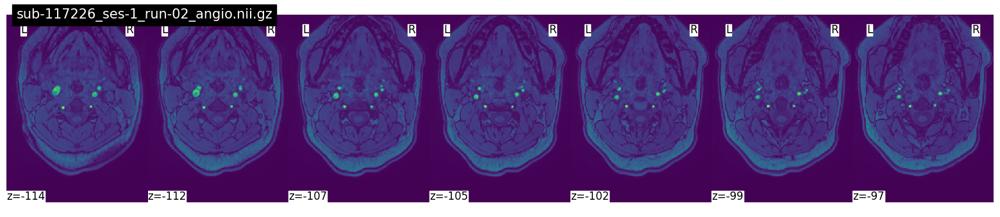

/sub-117226/ses-1/anat/sub-117226_ses-1_acq-axial_run-01_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-117226/ses-1/anat/sub-117226_ses-1_acq-axial_run-01_minIP.nii.gz


/gpfs/fs001/cbica/projects/grmpy/micromamba/envs/cubids/lib/python3.11/site-packages/nilearn/plotting/find_cuts.py:313: UserWarning: Too many cuts requested for the data: n_cuts=7, data size=1.
  warnings.warn(


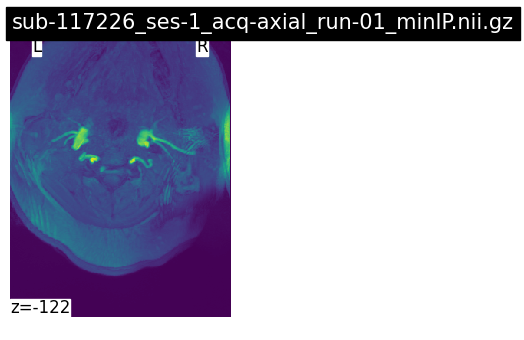

/sub-117226/ses-1/anat/sub-117226_ses-1_acq-axial_run-02_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-117226/ses-1/anat/sub-117226_ses-1_acq-axial_run-02_minIP.nii.gz


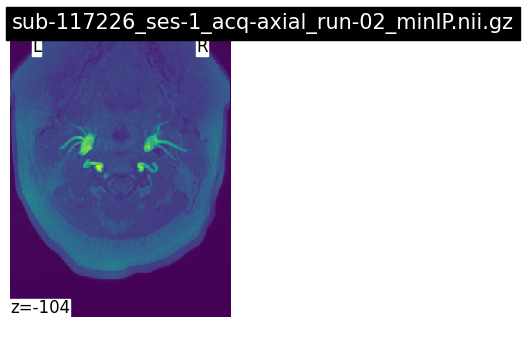

/sub-117226/ses-1/anat/sub-117226_ses-1_acq-coronal_run-01_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-117226/ses-1/anat/sub-117226_ses-1_acq-coronal_run-01_minIP.nii.gz


/gpfs/fs001/cbica/projects/grmpy/micromamba/envs/cubids/lib/python3.11/site-packages/nilearn/plotting/displays/_slicers.py:1497: UserWarning: A non-diagonal affine is found in the given image. Reordering the image to get diagonal affine for finding cuts in the slices.
  cut_coords = find_cut_slices(
/gpfs/fs001/cbica/projects/grmpy/micromamba/envs/cubids/lib/python3.11/site-packages/nilearn/plotting/displays/_axes.py:74: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  im = getattr(ax, type)(
/gpfs/fs001/cbica/projects/grmpy/micromamba/envs/cubids/lib/python3.11/site-packages/nilearn/plotting/displays/_axes.py:52: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.axis(self.get_object_bounds())


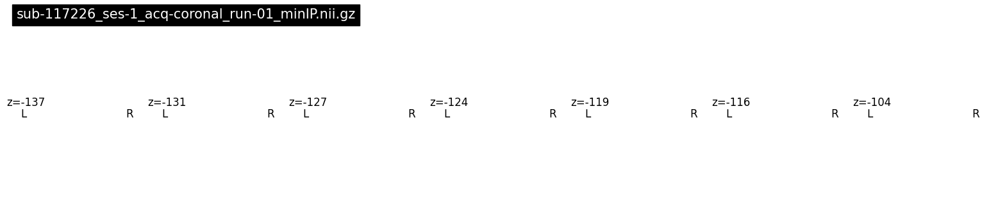

/sub-117226/ses-1/anat/sub-117226_ses-1_acq-coronal_run-02_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-117226/ses-1/anat/sub-117226_ses-1_acq-coronal_run-02_minIP.nii.gz


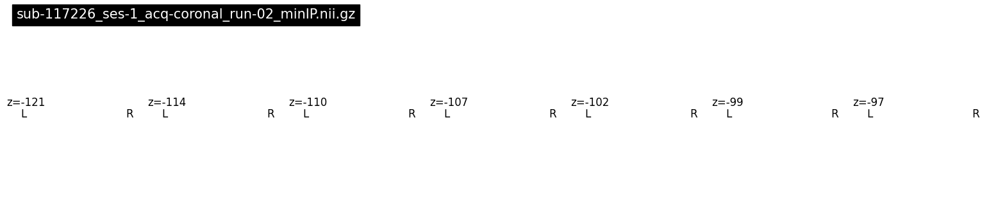

/sub-117226/ses-1/anat/sub-117226_ses-1_acq-sagittal_run-01_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-117226/ses-1/anat/sub-117226_ses-1_acq-sagittal_run-01_minIP.nii.gz


/gpfs/fs001/cbica/projects/grmpy/micromamba/envs/cubids/lib/python3.11/site-packages/nilearn/plotting/displays/_axes.py:74: UserWarning: Attempting to set identical low and high xlims makes transformation singular; automatically expanding.
  im = getattr(ax, type)(
/gpfs/fs001/cbica/projects/grmpy/micromamba/envs/cubids/lib/python3.11/site-packages/nilearn/plotting/displays/_axes.py:52: UserWarning: Attempting to set identical low and high xlims makes transformation singular; automatically expanding.
  self.ax.axis(self.get_object_bounds())
/gpfs/fs001/cbica/projects/grmpy/micromamba/envs/cubids/lib/python3.11/site-packages/nilearn/plotting/displays/_slicers.py:1578: RuntimeWarning: invalid value encountered in scalar divide
  width_dict[ax] = width / total_width * (x1 - x0)


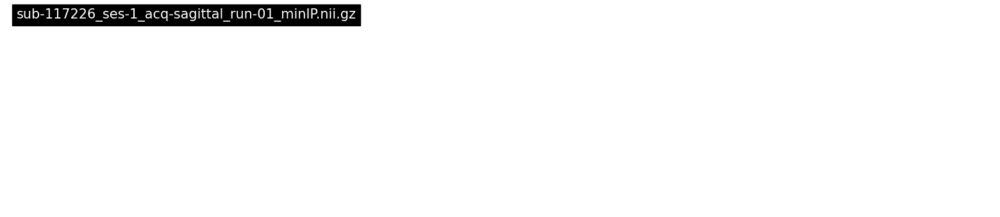

/sub-117226/ses-1/anat/sub-117226_ses-1_acq-sagittal_run-02_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-117226/ses-1/anat/sub-117226_ses-1_acq-sagittal_run-02_minIP.nii.gz


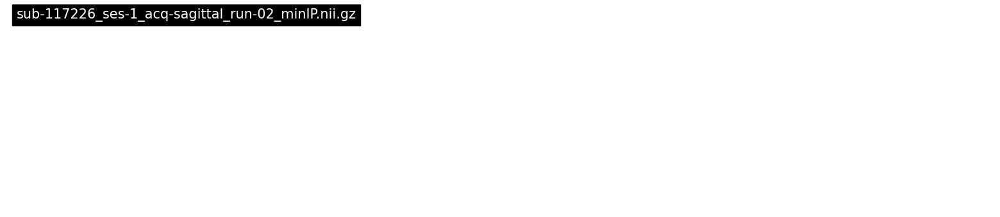

/sub-117226/ses-1/anat/sub-117226_ses-1_rec-defaced_run-01_T1w.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-117226/ses-1/anat/sub-117226_ses-1_rec-defaced_run-01_T1w.nii.gz


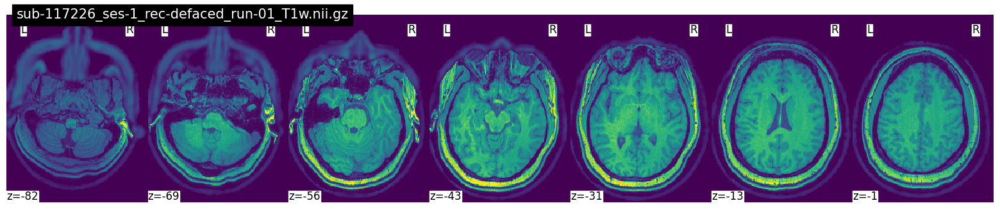

/sub-117226/ses-1/anat/sub-117226_ses-1_rec-defaced_run-02_T1w.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-117226/ses-1/anat/sub-117226_ses-1_rec-defaced_run-02_T1w.nii.gz


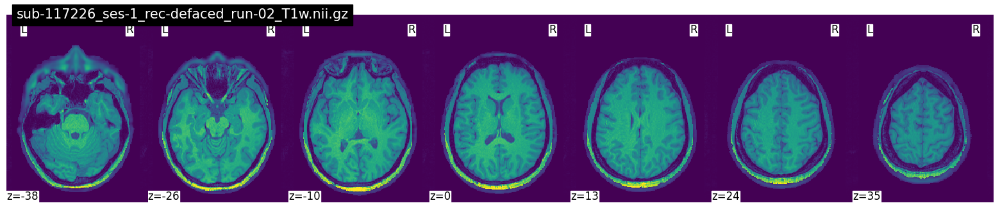

/sub-118393/ses-1/anat/sub-118393_ses-1_run-01_angio.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-118393/ses-1/anat/sub-118393_ses-1_run-01_angio.nii.gz


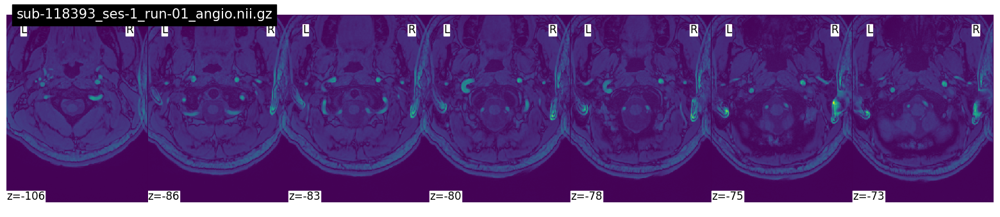

/sub-118393/ses-1/anat/sub-118393_ses-1_run-02_angio.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-118393/ses-1/anat/sub-118393_ses-1_run-02_angio.nii.gz


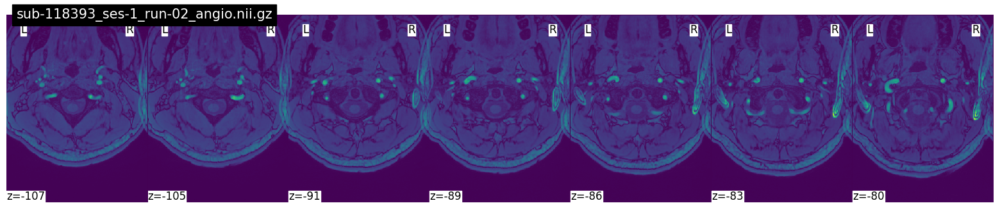

/sub-118393/ses-1/anat/sub-118393_ses-1_acq-axial_run-01_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-118393/ses-1/anat/sub-118393_ses-1_acq-axial_run-01_minIP.nii.gz


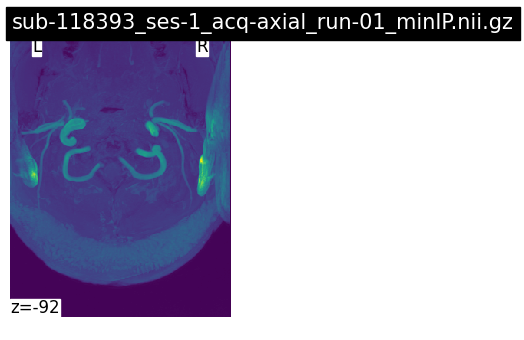

/sub-118393/ses-1/anat/sub-118393_ses-1_acq-axial_run-02_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-118393/ses-1/anat/sub-118393_ses-1_acq-axial_run-02_minIP.nii.gz


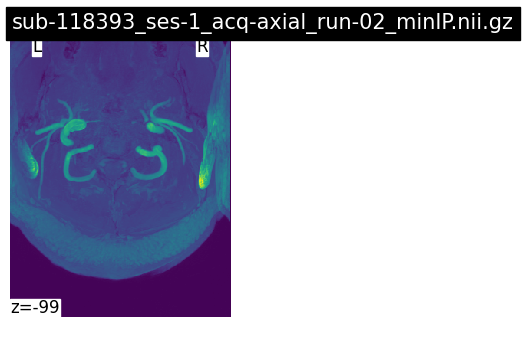

/sub-118393/ses-1/anat/sub-118393_ses-1_acq-coronal_run-01_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-118393/ses-1/anat/sub-118393_ses-1_acq-coronal_run-01_minIP.nii.gz


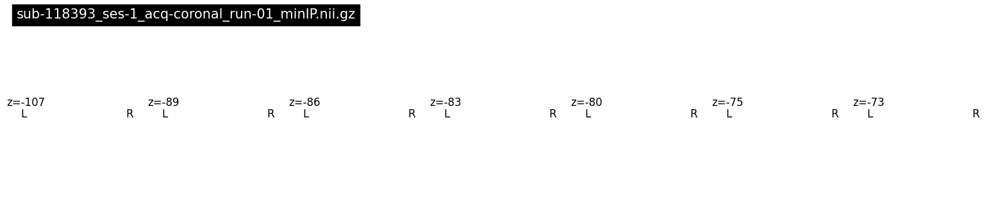

/sub-118393/ses-1/anat/sub-118393_ses-1_acq-coronal_run-02_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-118393/ses-1/anat/sub-118393_ses-1_acq-coronal_run-02_minIP.nii.gz


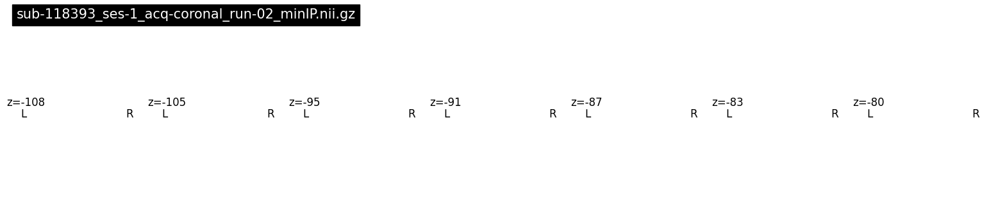

/sub-118393/ses-1/anat/sub-118393_ses-1_acq-sagittal_run-01_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-118393/ses-1/anat/sub-118393_ses-1_acq-sagittal_run-01_minIP.nii.gz


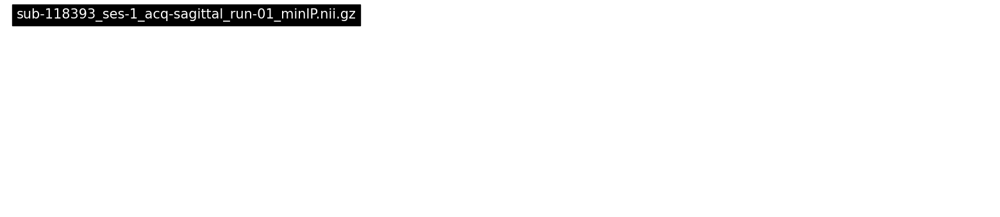

/sub-118393/ses-1/anat/sub-118393_ses-1_acq-sagittal_run-02_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-118393/ses-1/anat/sub-118393_ses-1_acq-sagittal_run-02_minIP.nii.gz


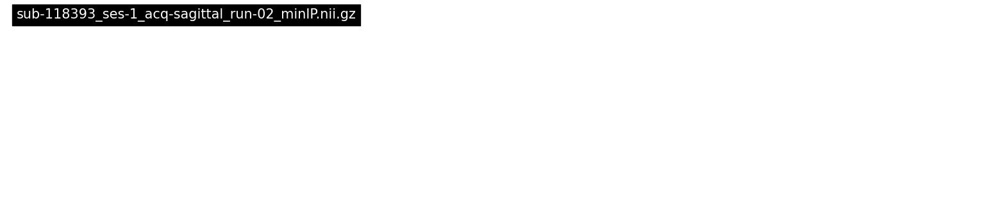

/sub-121407/ses-1/anat/sub-121407_ses-1_run-01_angio.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-121407/ses-1/anat/sub-121407_ses-1_run-01_angio.nii.gz


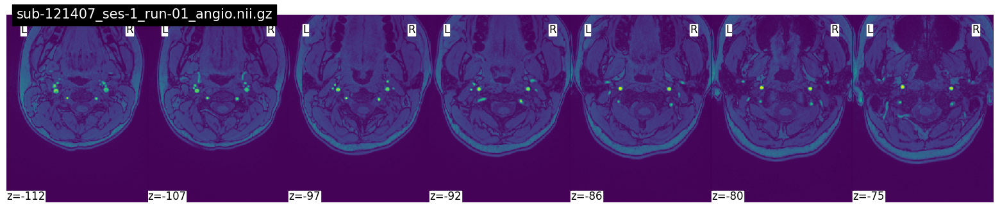

/sub-121407/ses-1/anat/sub-121407_ses-1_run-02_angio.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-121407/ses-1/anat/sub-121407_ses-1_run-02_angio.nii.gz


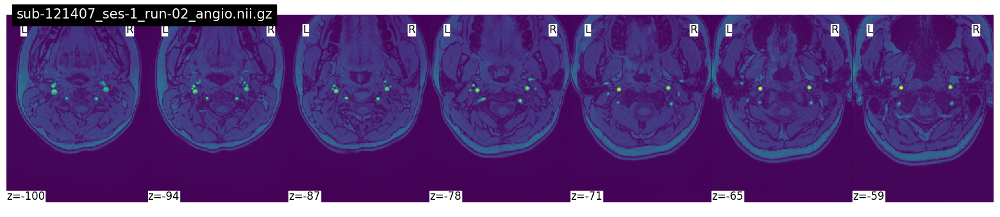

/sub-121407/ses-1/anat/sub-121407_ses-1_acq-axial_run-01_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-121407/ses-1/anat/sub-121407_ses-1_acq-axial_run-01_minIP.nii.gz


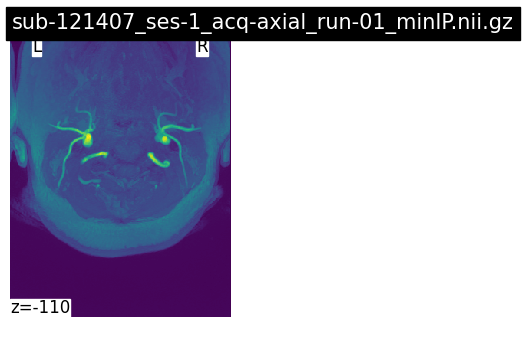

/sub-121407/ses-1/anat/sub-121407_ses-1_acq-axial_run-02_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-121407/ses-1/anat/sub-121407_ses-1_acq-axial_run-02_minIP.nii.gz


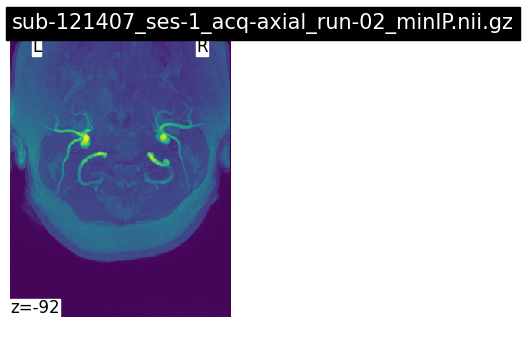

/sub-121407/ses-1/anat/sub-121407_ses-1_acq-coronal_run-01_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-121407/ses-1/anat/sub-121407_ses-1_acq-coronal_run-01_minIP.nii.gz


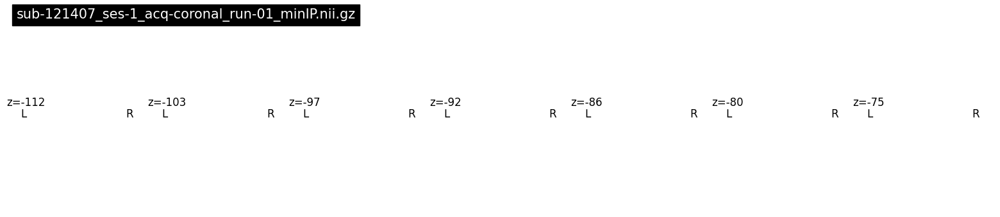

/sub-121407/ses-1/anat/sub-121407_ses-1_acq-coronal_run-02_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-121407/ses-1/anat/sub-121407_ses-1_acq-coronal_run-02_minIP.nii.gz


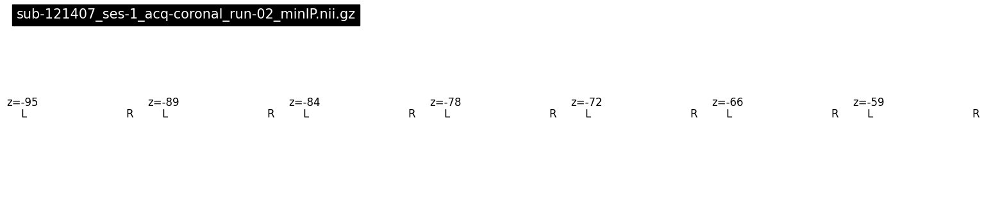

/sub-121407/ses-1/anat/sub-121407_ses-1_acq-sagittal_run-01_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-121407/ses-1/anat/sub-121407_ses-1_acq-sagittal_run-01_minIP.nii.gz


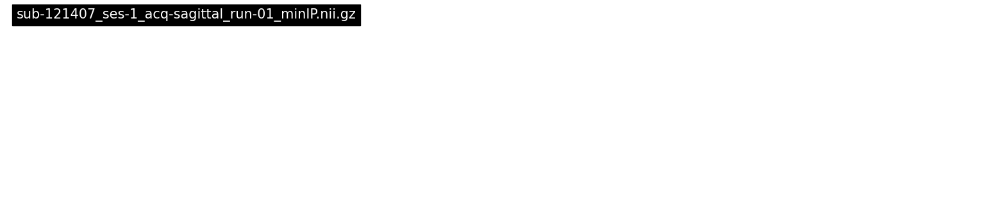

/sub-121407/ses-1/anat/sub-121407_ses-1_acq-sagittal_run-02_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-121407/ses-1/anat/sub-121407_ses-1_acq-sagittal_run-02_minIP.nii.gz


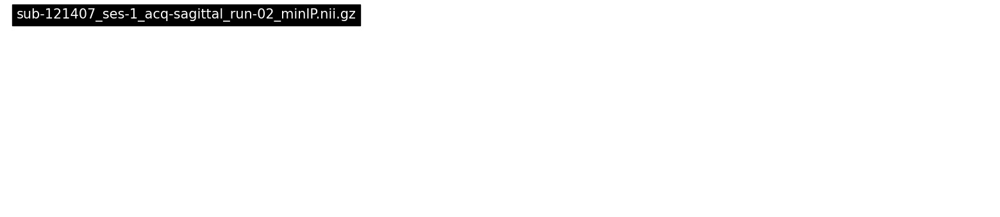

/sub-121407/ses-1/anat/sub-121407_ses-1_rec-defaced_run-01_T1w.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-121407/ses-1/anat/sub-121407_ses-1_rec-defaced_run-01_T1w.nii.gz


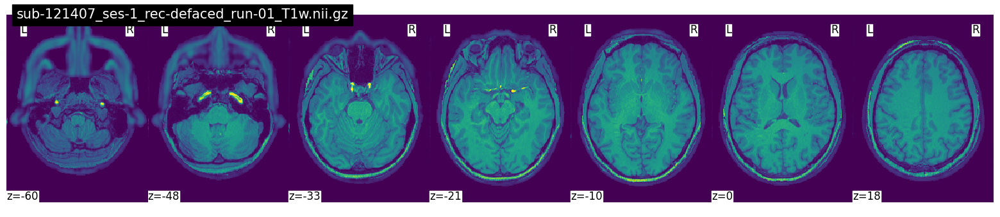

/sub-121407/ses-1/anat/sub-121407_ses-1_rec-defaced_run-02_T1w.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-121407/ses-1/anat/sub-121407_ses-1_rec-defaced_run-02_T1w.nii.gz


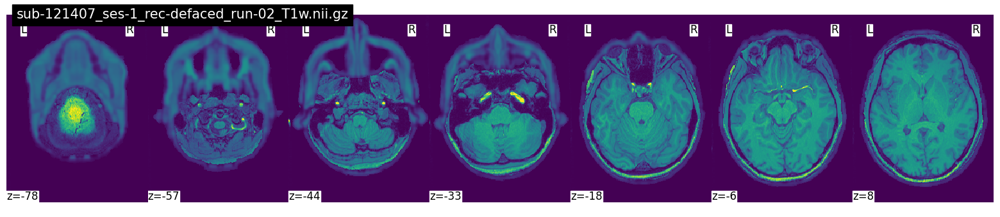

/sub-129405/ses-1/anat/sub-129405_ses-1_rec-defaced_run-01_T1w.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-129405/ses-1/anat/sub-129405_ses-1_rec-defaced_run-01_T1w.nii.gz


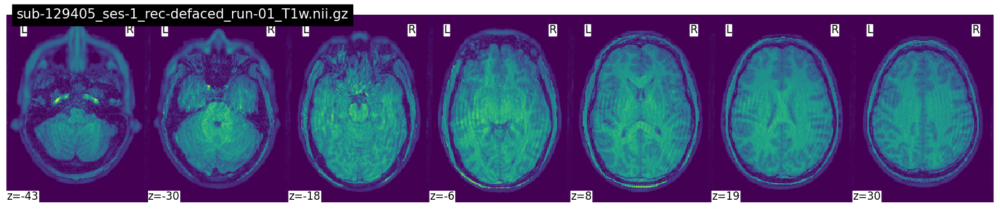

/sub-129405/ses-1/anat/sub-129405_ses-1_rec-defaced_run-02_T1w.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-129405/ses-1/anat/sub-129405_ses-1_rec-defaced_run-02_T1w.nii.gz


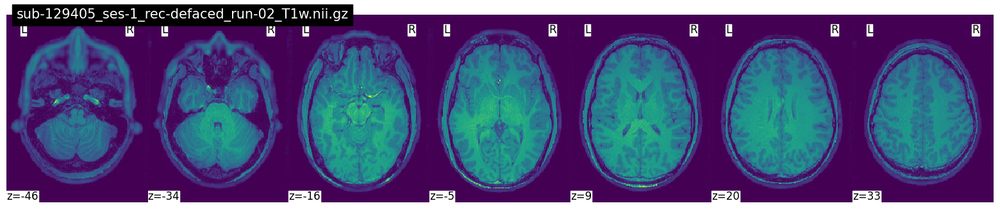

/sub-20940/ses-1/anat/sub-20940_ses-1_rec-defaced_run-01_T1w.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-20940/ses-1/anat/sub-20940_ses-1_rec-defaced_run-01_T1w.nii.gz


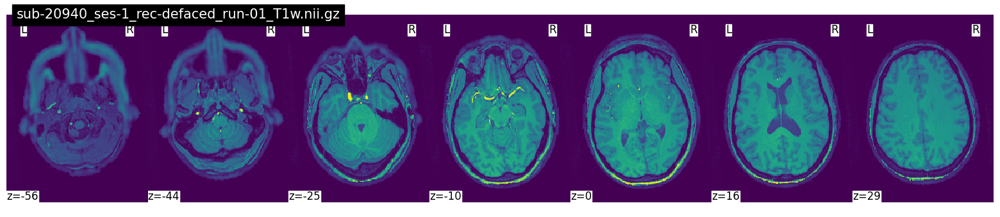

/sub-20940/ses-1/anat/sub-20940_ses-1_rec-defaced_run-02_T1w.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-20940/ses-1/anat/sub-20940_ses-1_rec-defaced_run-02_T1w.nii.gz


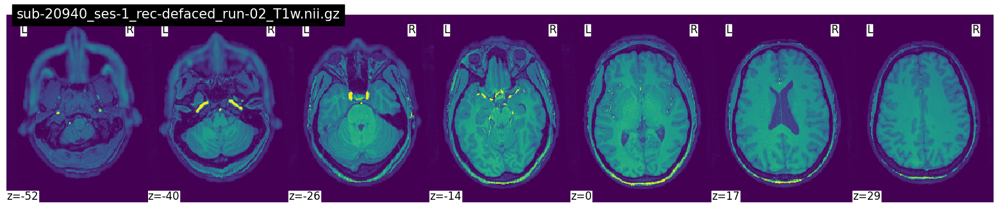

/sub-20981/ses-1/anat/sub-20981_ses-1_rec-defaced_run-01_T1w.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-20981/ses-1/anat/sub-20981_ses-1_rec-defaced_run-01_T1w.nii.gz


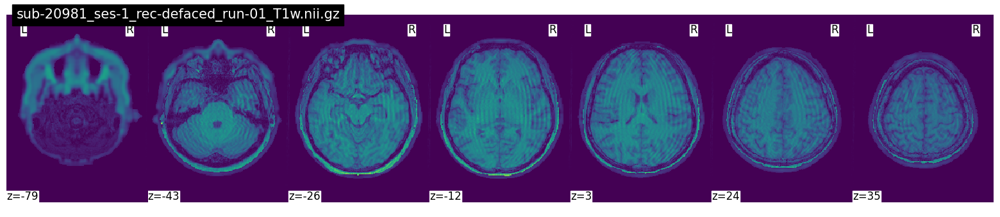

/sub-20981/ses-1/anat/sub-20981_ses-1_rec-defaced_run-02_T1w.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-20981/ses-1/anat/sub-20981_ses-1_rec-defaced_run-02_T1w.nii.gz


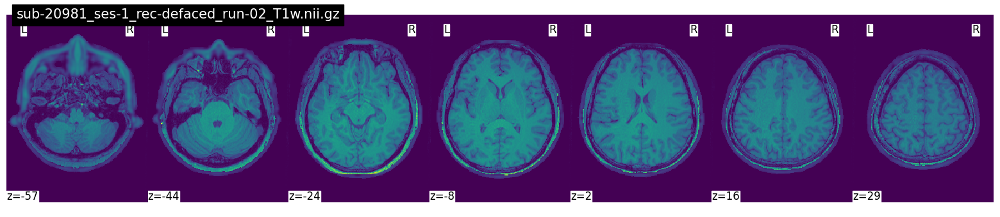

/sub-83999/ses-1/anat/sub-83999_ses-1_run-01_angio.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-83999/ses-1/anat/sub-83999_ses-1_run-01_angio.nii.gz


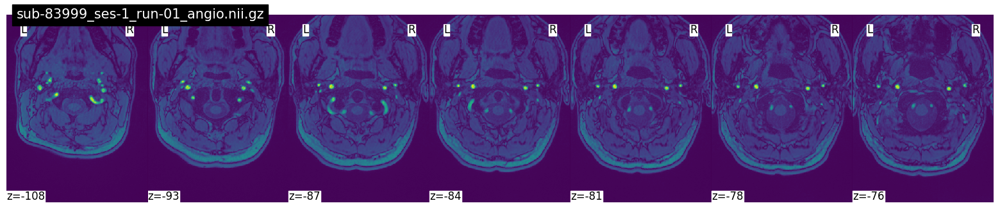

/sub-83999/ses-1/anat/sub-83999_ses-1_run-02_angio.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-83999/ses-1/anat/sub-83999_ses-1_run-02_angio.nii.gz


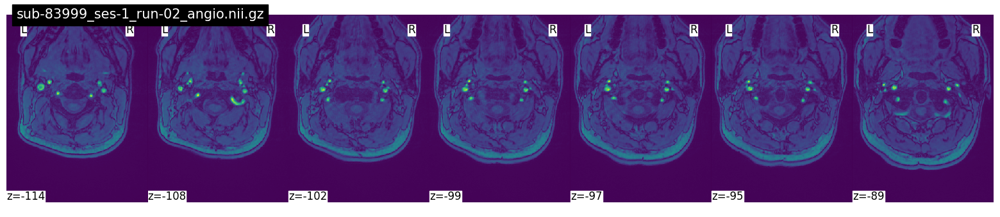

/sub-83999/ses-1/anat/sub-83999_ses-1_acq-axial_run-01_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-83999/ses-1/anat/sub-83999_ses-1_acq-axial_run-01_minIP.nii.gz


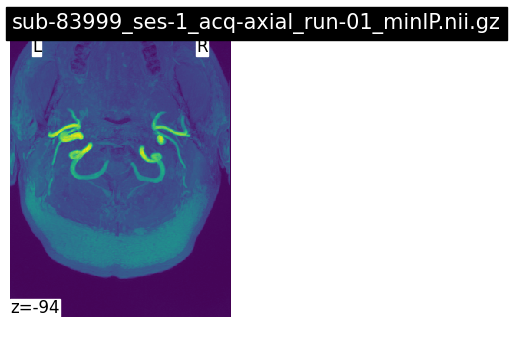

/sub-83999/ses-1/anat/sub-83999_ses-1_acq-axial_run-02_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-83999/ses-1/anat/sub-83999_ses-1_acq-axial_run-02_minIP.nii.gz


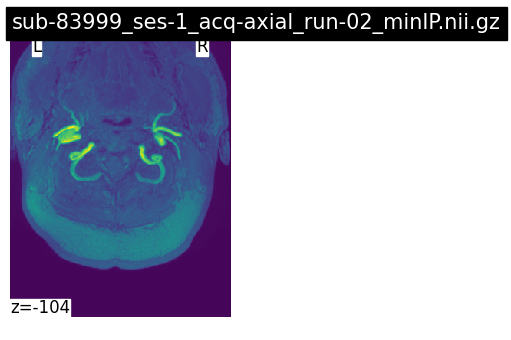

/sub-83999/ses-1/anat/sub-83999_ses-1_acq-coronal_run-01_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-83999/ses-1/anat/sub-83999_ses-1_acq-coronal_run-01_minIP.nii.gz


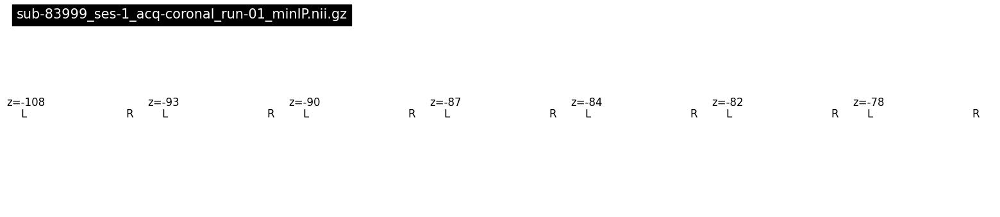

/sub-83999/ses-1/anat/sub-83999_ses-1_acq-coronal_run-02_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-83999/ses-1/anat/sub-83999_ses-1_acq-coronal_run-02_minIP.nii.gz


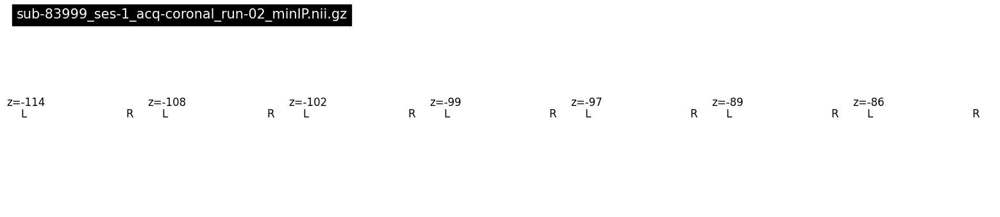

/sub-83999/ses-1/anat/sub-83999_ses-1_acq-sagittal_run-01_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-83999/ses-1/anat/sub-83999_ses-1_acq-sagittal_run-01_minIP.nii.gz


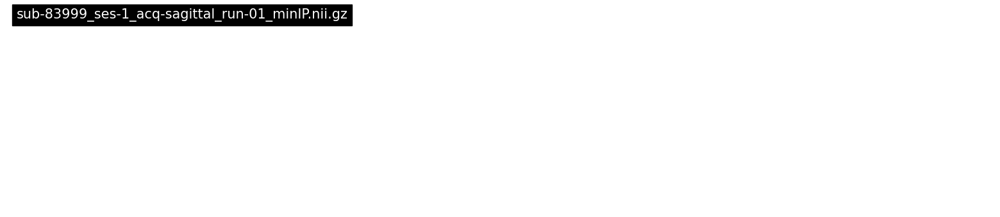

/sub-83999/ses-1/anat/sub-83999_ses-1_acq-sagittal_run-02_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-83999/ses-1/anat/sub-83999_ses-1_acq-sagittal_run-02_minIP.nii.gz


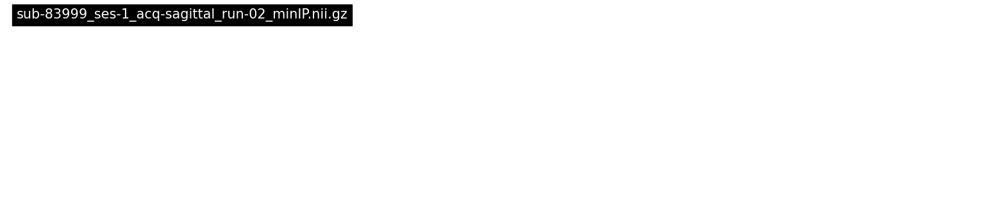

/sub-85173/ses-1/anat/sub-85173_ses-1_run-01_angio.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-85173/ses-1/anat/sub-85173_ses-1_run-01_angio.nii.gz


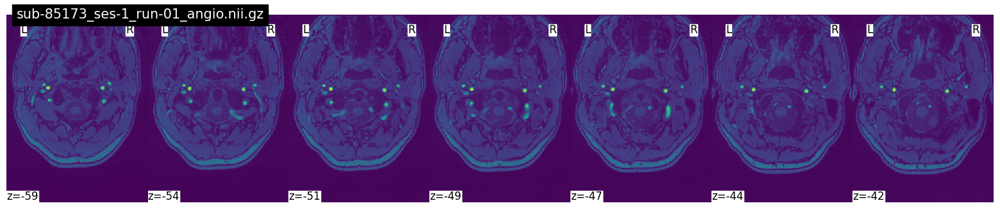

/sub-85173/ses-1/anat/sub-85173_ses-1_run-02_angio.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-85173/ses-1/anat/sub-85173_ses-1_run-02_angio.nii.gz


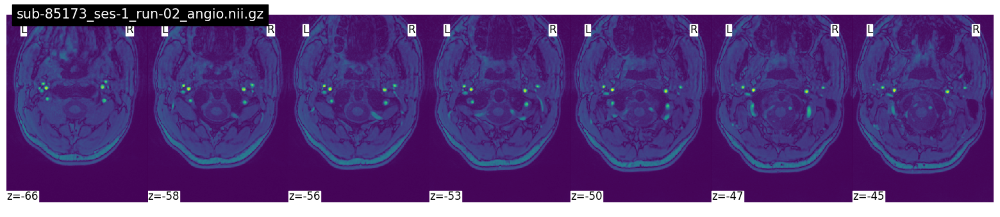

/sub-85173/ses-1/anat/sub-85173_ses-1_acq-axial_run-01_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-85173/ses-1/anat/sub-85173_ses-1_acq-axial_run-01_minIP.nii.gz


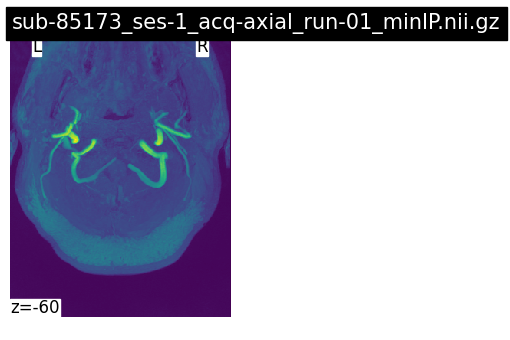

/sub-85173/ses-1/anat/sub-85173_ses-1_acq-axial_run-02_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-85173/ses-1/anat/sub-85173_ses-1_acq-axial_run-02_minIP.nii.gz


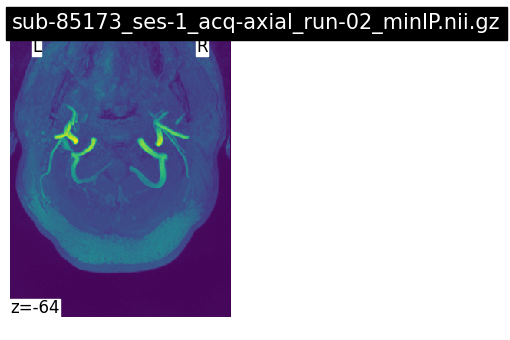

/sub-85173/ses-1/anat/sub-85173_ses-1_acq-coronal_run-01_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-85173/ses-1/anat/sub-85173_ses-1_acq-coronal_run-01_minIP.nii.gz


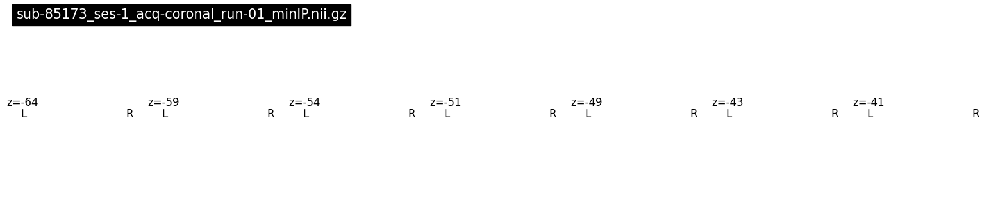

/sub-85173/ses-1/anat/sub-85173_ses-1_acq-coronal_run-02_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-85173/ses-1/anat/sub-85173_ses-1_acq-coronal_run-02_minIP.nii.gz


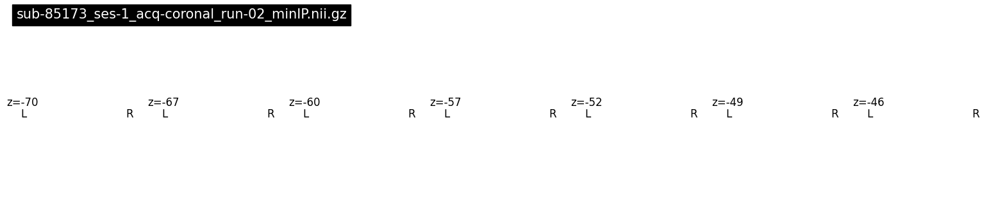

/sub-85173/ses-1/anat/sub-85173_ses-1_acq-sagittal_run-01_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-85173/ses-1/anat/sub-85173_ses-1_acq-sagittal_run-01_minIP.nii.gz


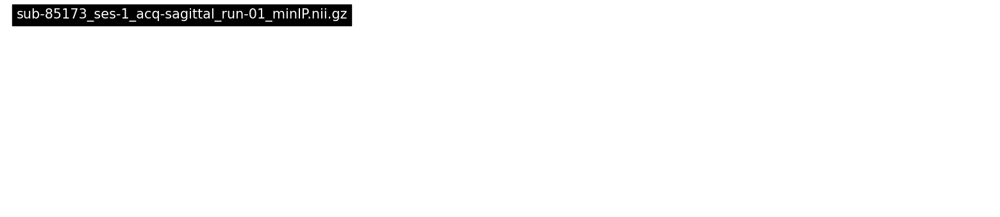

/sub-85173/ses-1/anat/sub-85173_ses-1_acq-sagittal_run-02_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-85173/ses-1/anat/sub-85173_ses-1_acq-sagittal_run-02_minIP.nii.gz


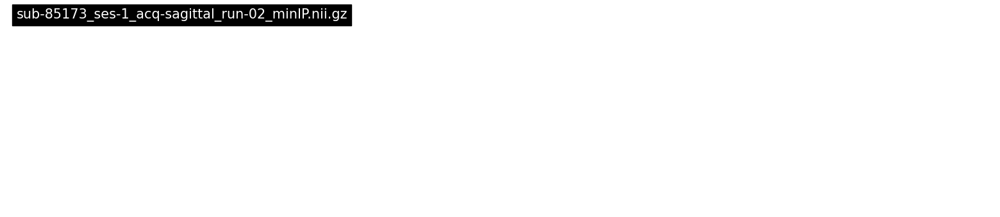

/sub-87538/ses-1/anat/sub-87538_ses-1_run-01_angio.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-87538/ses-1/anat/sub-87538_ses-1_run-01_angio.nii.gz


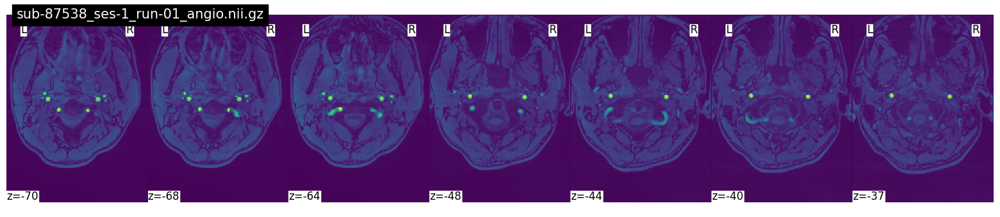

/sub-87538/ses-1/anat/sub-87538_ses-1_run-02_angio.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-87538/ses-1/anat/sub-87538_ses-1_run-02_angio.nii.gz


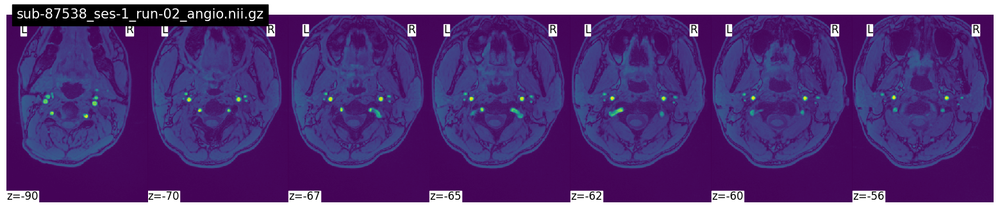

/sub-87538/ses-1/anat/sub-87538_ses-1_run-03_angio.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-87538/ses-1/anat/sub-87538_ses-1_run-03_angio.nii.gz


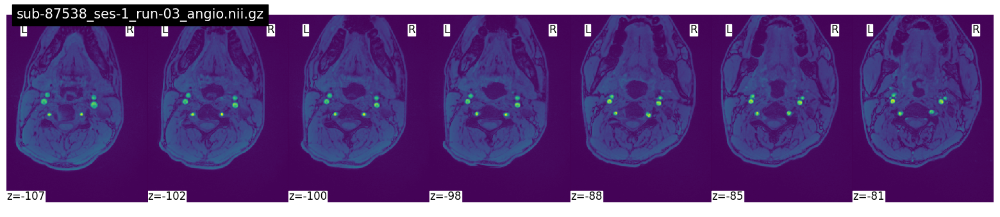

/sub-87538/ses-1/anat/sub-87538_ses-1_acq-axial_run-01_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-87538/ses-1/anat/sub-87538_ses-1_acq-axial_run-01_minIP.nii.gz


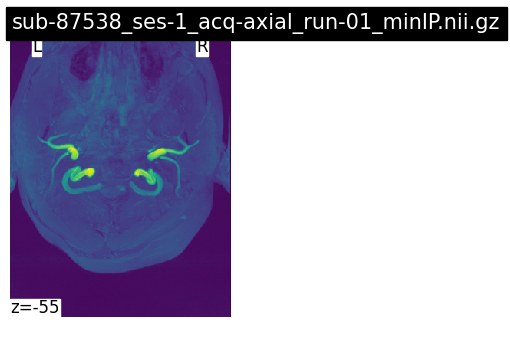

/sub-87538/ses-1/anat/sub-87538_ses-1_acq-axial_run-02_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-87538/ses-1/anat/sub-87538_ses-1_acq-axial_run-02_minIP.nii.gz


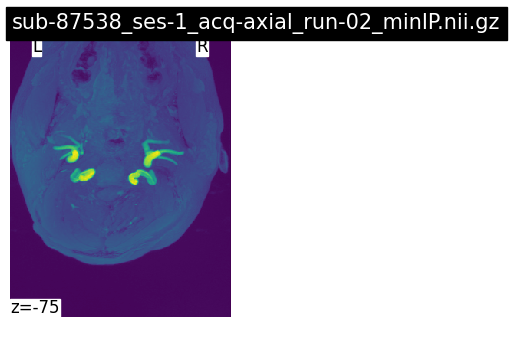

/sub-87538/ses-1/anat/sub-87538_ses-1_acq-axial_run-03_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-87538/ses-1/anat/sub-87538_ses-1_acq-axial_run-03_minIP.nii.gz


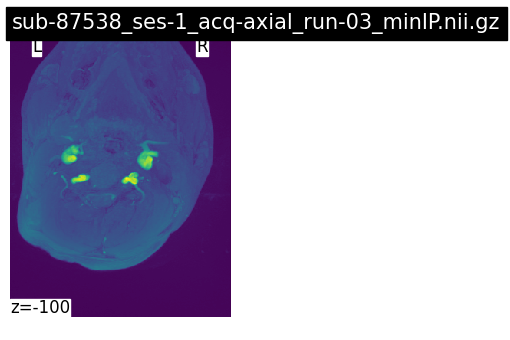

/sub-87538/ses-1/anat/sub-87538_ses-1_acq-coronal_run-01_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-87538/ses-1/anat/sub-87538_ses-1_acq-coronal_run-01_minIP.nii.gz


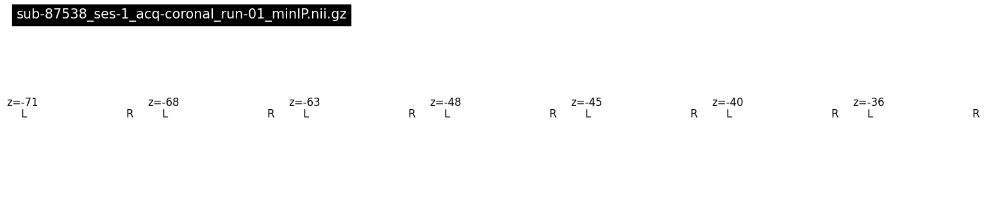

/sub-87538/ses-1/anat/sub-87538_ses-1_acq-coronal_run-02_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-87538/ses-1/anat/sub-87538_ses-1_acq-coronal_run-02_minIP.nii.gz


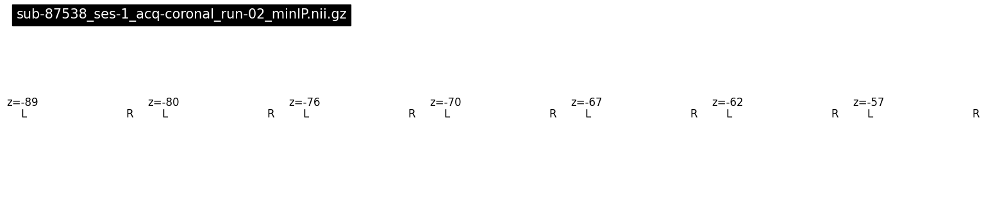

/sub-87538/ses-1/anat/sub-87538_ses-1_acq-coronal_run-03_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-87538/ses-1/anat/sub-87538_ses-1_acq-coronal_run-03_minIP.nii.gz


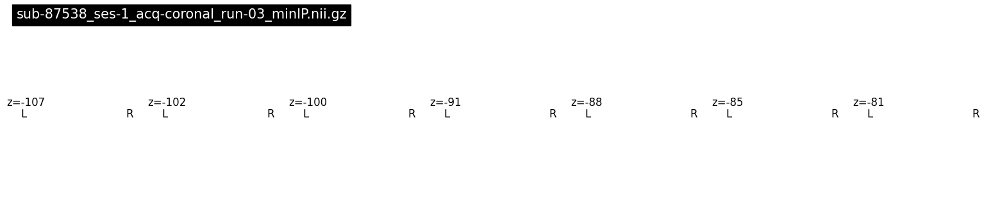

/sub-87538/ses-1/anat/sub-87538_ses-1_acq-sagittal_run-01_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-87538/ses-1/anat/sub-87538_ses-1_acq-sagittal_run-01_minIP.nii.gz


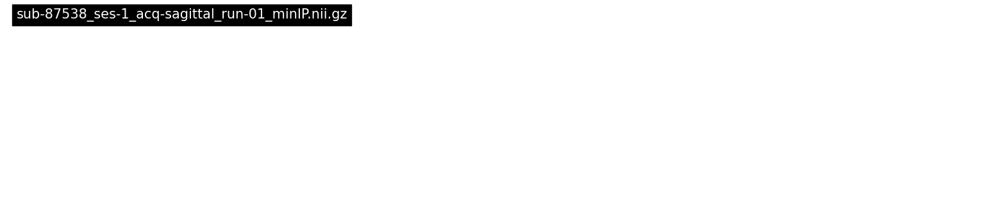

/sub-87538/ses-1/anat/sub-87538_ses-1_acq-sagittal_run-02_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-87538/ses-1/anat/sub-87538_ses-1_acq-sagittal_run-02_minIP.nii.gz


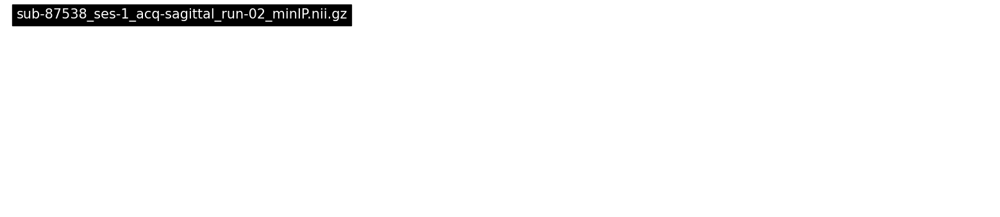

/sub-87538/ses-1/anat/sub-87538_ses-1_acq-sagittal_run-03_minIP.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-87538/ses-1/anat/sub-87538_ses-1_acq-sagittal_run-03_minIP.nii.gz


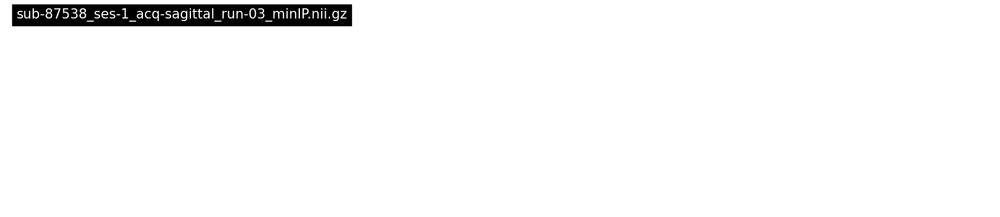

/sub-95015/ses-1/anat/sub-95015_ses-1_rec-defaced_run-01_T2w.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-95015/ses-1/anat/sub-95015_ses-1_rec-defaced_run-01_T2w.nii.gz


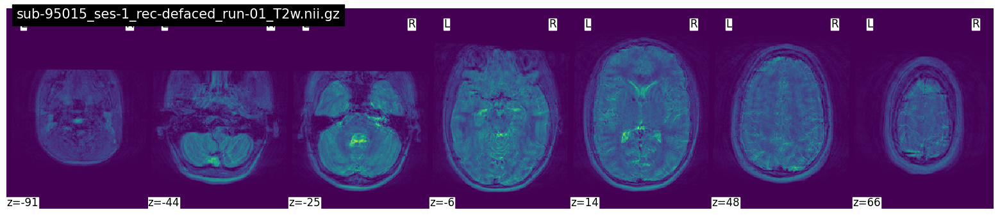

/sub-95015/ses-1/anat/sub-95015_ses-1_rec-defaced_run-02_T2w.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-95015/ses-1/anat/sub-95015_ses-1_rec-defaced_run-02_T2w.nii.gz


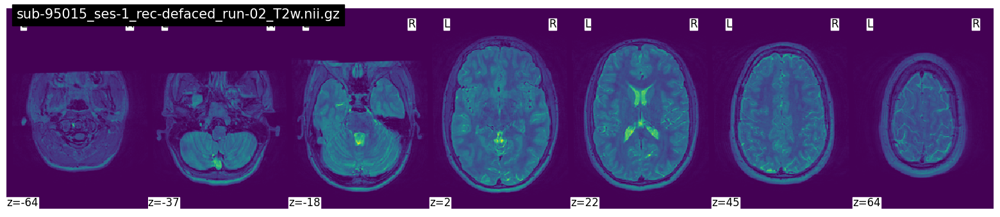

/sub-98394/ses-1/anat/sub-98394_ses-1_rec-defaced_run-01_T1w.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-98394/ses-1/anat/sub-98394_ses-1_rec-defaced_run-01_T1w.nii.gz


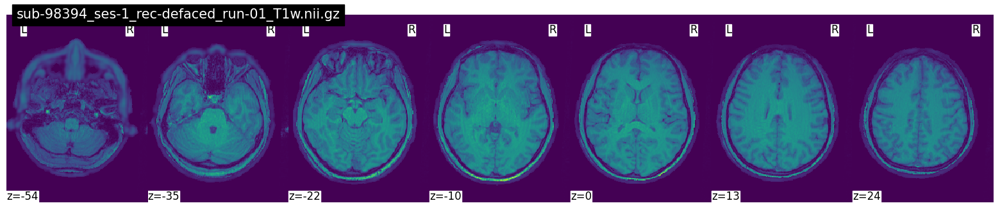

/sub-98394/ses-1/anat/sub-98394_ses-1_rec-defaced_run-02_T1w.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-98394/ses-1/anat/sub-98394_ses-1_rec-defaced_run-02_T1w.nii.gz


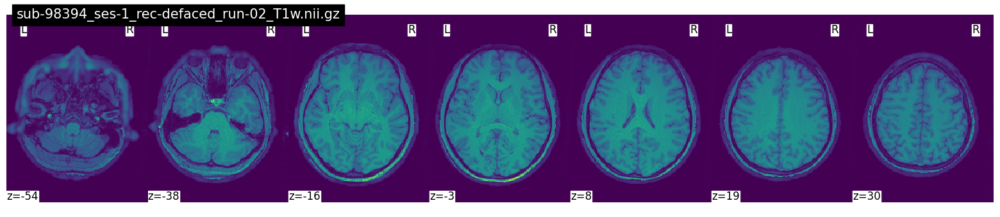

In [7]:
for file in anat_inspect:
    print(file)
    filename = os.path.basename(file)
    title = f"{filename}"
    file = file.lstrip('/')
    fullpath = os.path.join(base_dir, file)
    print(fullpath)
    # Generate the plot
    display = plotting.plot_img(
        fullpath,
        title=title,
        draw_cross=False,
        annotate=True,
        display_mode='z',
#         dim=-1,
#         cut_coords=[10, 20, 30, 40, 50, 60]
    )

    plt.show()  # Display the plot
    display.close()  # Close the display object to free memory

/sub-83999/ses-1/anat/sub-83999_ses-1_run-02_angio.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-83999/ses-1/anat/sub-83999_ses-1_run-02_angio.nii.gz


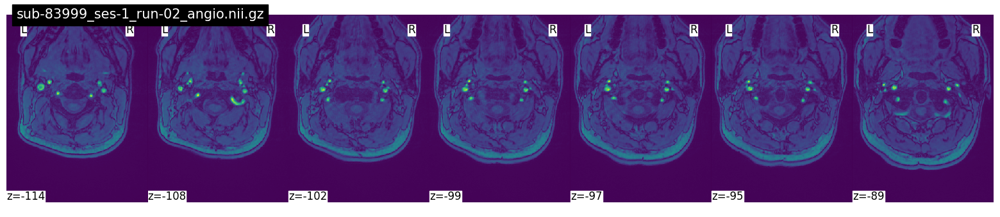

/sub-83999/ses-1/anat/sub-83999_ses-1_run-01_angio.nii.gz
/cbica/projects/grmpy/data/bids_datalad/sub-83999/ses-1/anat/sub-83999_ses-1_run-01_angio.nii.gz


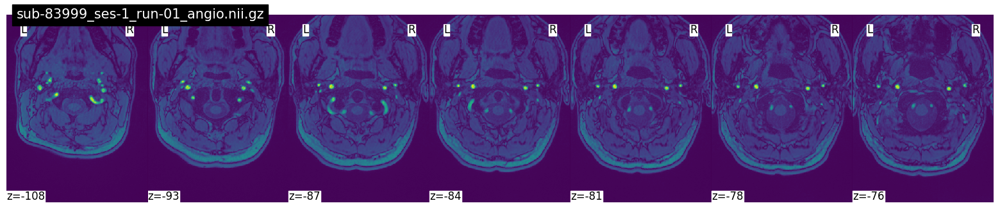

In [8]:
files = {'/sub-83999/ses-1/anat/sub-83999_ses-1_run-01_angio.nii.gz', '/sub-83999/ses-1/anat/sub-83999_ses-1_run-02_angio.nii.gz'}

for file in files:
    print(file)
    filename = os.path.basename(file)
    title = f"{filename}"
    file = file.lstrip('/')
    fullpath = os.path.join(base_dir, file)
    print(fullpath)
    # Generate the plot
    display = plotting.plot_img(
        fullpath,
        title=title,
        draw_cross=False,
        annotate=True,
        display_mode='z',
#         dim=-1,
#         cut_coords=[10, 20, 30, 40, 50, 60]
    )

    plt.show()  # Display the plot
    display.close()  # Close the display object to free memory